# DCGAN
- 解説：https://towardsdatascience.com/an-end-to-end-introduction-to-gans-bf253f1fa52f
- コード：https://colab.research.google.com/drive/1Mxbfn0BUW4BlgEPc-minaE_M0_PaYIIX

## ジェネレーターのアーキテクチャ

- 基本的に、ジェネレーターニューラルネットワークは、100個のサイズの通常生成された数値のベクトルを入力として受け取り、画像を提供するブラックボックスと考えることができます。


- サイズ4x4x1024の高密度レイヤーを使用して、この100-dベクトルから高密度ベクターを作成します。次に、次の図に示すように、1024個のフィルターを使用して4x4のイメージの形状にこの密なベクトルを再形成します。


- 1024個の4x4マップを取得したら、一連の転置畳み込みを使用してアップサンプリングを行います。これにより、各操作後に画像のサイズが2倍になり、マップの数が半分になります。最後のステップでは、マップの数を半分にせずに、出力画像用に3つのチャネルが必要なため、RGBチャンネルごとに3つのチャンネル/マップに減らします。

## 弁別器（Discriminator）のアーキテクチャ
- 実際には、次の図に示すように、画像が偽物かどうかを予測するために、一連の畳み込み層と最後に密な層が含まれています。


- 入力として画像を取り、それが本物か偽物かを予測

In [1]:
import os
import glob
os.environ["KERAS_BACKEND"] = "tensorflow"
import numpy as np
from sklearn.utils import shuffle
import time
import cv2
import scipy
from PIL import Image
import matplotlib.gridspec as gridspec
from keras.layers import Dense
from keras.layers import Reshape
from keras.layers.core import Activation
from keras.layers.normalization import BatchNormalization
from keras.layers.convolutional import UpSampling2D
from keras.layers.pooling import MaxPooling2D
from keras.layers.core import Flatten
from keras.layers import Conv2D, Conv2DTranspose, Dropout
from keras.models import Model
from keras.optimizers import SGD, Adam, RMSprop
from keras.layers.advanced_activations import LeakyReLU
import matplotlib.pyplot as plt
from keras.models import load_model
from keras.utils.vis_utils import plot_model
import keras.backend as K
#from scipy.interpolate import spline
K.set_image_dim_ordering('tf')
import numpy as np
from sklearn.utils import shuffle
import tensorflow as tf
from keras.backend.tensorflow_backend import set_session
from keras.layers import Input, merge
from keras.initializers import RandomNormal
K.set_image_dim_ordering('tf')
config = tf.ConfigProto()
config.gpu_options.allow_growth = True 
set_session(tf.Session(config=config))
from collections import deque
%matplotlib inline
from tqdm import tqdm_notebook as tqdm

Using TensorFlow backend.


## データ視覚化
- 画像のサイズと画像自体を確認できます。

Num_Images:  6506


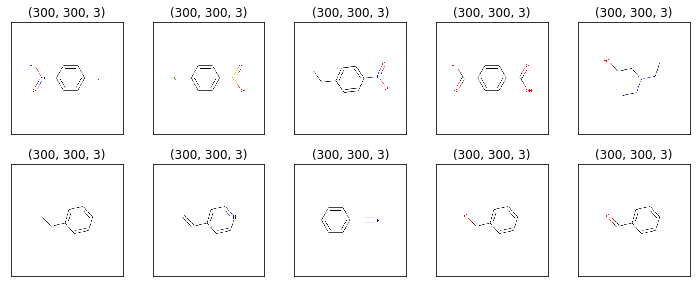

In [2]:
# rdkitから作成したAmesの画像使う
data_dir = r'D:\work\Ames_data\work\rdkit_img'
filenames = glob.glob(data_dir+'/*/*.png')

def plot_5imgs(filename_list, plot_num=10):
    """ 5枚ずつ並べて画像表示"""
    print("Num_Images: ",len(filename_list))
    plt.figure(figsize=(10, 8))
    for i in range(plot_num):
        img = plt.imread(filename_list[i], 0)
        plt.subplot(4, 5, i+1)
        plt.imshow(img)
        plt.title(img.shape)
        plt.xticks([])
        plt.yticks([])
    plt.tight_layout()
    plt.show()
    
plot_5imgs(filenames)

## データ前処理
- トレーニングを進める前に、画像を標準サイズの64x64x3に前処理する関数必要
- GANをトレーニングするために使用する前に、画像のピクセルを正規化する必要があります。

In [3]:
# A function to normalize image pixels.
def norm_img(img):
    '''画像を正規化する
    Input:
        img : Original image as numpy array.
    Output: Normailized Image as numpy array
    '''
    img = (img / 127.5) - 1
    return img

def denorm_img(img):
    '''Denormailze=正規化された画像を正規化前に戻す
    Input:
        img : Normalized image as numpy array.
    Output: Original Image as numpy array
    '''
    img = (img + 1) * 127.5
    return img.astype(np.uint8) 

def sample_from_dataset(batch_size, image_shape, data_dir=None):
    '''データディレクトリからランダムな画像をサンプリングして、画像サンプルのバッチを作成する
     image_shapeを使用して画像のサイズを変更し、画像を正規化する
    Input:
        batch_size : Sample size required
        image_size : Size that Image should be resized to
        data_dir : Path of directory where training images are placed.

    Output:
        sample : batch of processed images 
    '''
    sample_dim = (batch_size,) + image_shape
    sample = np.empty(sample_dim, dtype=np.float32)
    all_data_dirlist = list(glob.glob(data_dir))
    sample_imgs_paths = np.random.choice(all_data_dirlist,batch_size)
    for index,img_filename in enumerate(sample_imgs_paths):
        image = Image.open(img_filename)
        image = image.resize(image_shape[:-1])
        image = image.convert('RGB') 
        image = np.asarray(image)
        image = norm_img(image)
        sample[index,...] = image
    return sample

## DCGANの実装
- DCGANを定義する部分です。ノイズジェネレーター関数、ジェネレーターアーキテクチャ、およびディスクリミネーターアーキテクチャを定義します。

### Generatorのノイズベクトルの生成
- ジェネレータアーキテクチャを使用して画像に変換するノイズベクトルを生成
- 正規分布を使用

In [4]:
def gen_noise(batch_size, noise_shape):
    ''' 正規分布からサンプリングされた（batch_size, noise_shape）のshapeのnumpyベクトルを生成する
    Input:
        batch_size : size of batch
        noise_shape: shape of noise vector, normally kept as 100 
    Output:a numpy vector sampled from normal distribution of shape (batch_size,noise_shape)     
    '''
    return np.random.normal(0, 1, size=(batch_size,)+noise_shape)

### ジェネレーターのアーキテクチャ
- 転置畳み込み層をいくつか追加してジェネレーターを作成し、ノイズベクトルを画像にアップサンプリング


- データに合わせてアーキテクチャを変更する必要があったため、中央に畳み込み層を追加し、ジェネレータアーキテクチャからすべての密な層を削除して、完全に畳み込みにしました


- また、0.5のモメンタムとLeakyReLUアクティベーションを持つ多くのBatchnormレイヤーを使用します。私はβ= 0.5でAdamオプティマイザーを使用

In [5]:
def get_gen_normal(noise_shape):
    ''' ノイズベクトルのshapeを取り、Kerasジェネレーターアーキテクチャを作成する
    '''
    kernel_init = 'glorot_uniform'    
    gen_input = Input(shape = noise_shape) 
    
    # Transpose 2D conv layer 1. 
    generator = Conv2DTranspose(filters = 512, kernel_size = (4,4), strides = (1,1), padding = "valid", data_format = "channels_last", kernel_initializer = kernel_init)(gen_input)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Transpose 2D conv layer 2.
    generator = Conv2DTranspose(filters = 256, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Transpose 2D conv layer 3.
    generator = Conv2DTranspose(filters = 128, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Transpose 2D conv layer 4.
    generator = Conv2DTranspose(filters = 64, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # conv 2D layer 1.
    generator = Conv2D(filters = 64, kernel_size = (3,3), strides = (1,1), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Final Transpose 2D conv layer 5 to generate final image. Filter size 3 for 3 image channel
    generator = Conv2DTranspose(filters = 3, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    
    # Tanh activation to get final normalized image
    generator = Activation('tanh')(generator)
    
    # defining the optimizer and compiling the generator model.
    gen_opt = Adam(lr=0.00015, beta_1=0.5)
    generator_model = Model(input = gen_input, output = generator)
    generator_model.compile(loss='binary_crossentropy', optimizer=gen_opt, metrics=['accuracy'])
    generator_model.summary()
    return generator_model

### 弁別器（Discriminator）のアーキテクチャ
- 画像が偽物かどうかを予測するために、一連の畳み込み層と最後に密な層を使用する識別器アーキテクチャ

In [6]:
def get_disc_normal(image_shape=(64,64,3)):
    ''' Discriminatorのアーキテクチャを作成する
    '''
    dropout_prob = 0.4
    kernel_init = 'glorot_uniform'
    dis_input = Input(shape = image_shape)
    
    # Conv layer 1:
    discriminator = Conv2D(filters = 64, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(dis_input)
    discriminator = LeakyReLU(0.2)(discriminator)
    # Conv layer 2:
    discriminator = Conv2D(filters = 128, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)
    # Conv layer 3:   
    discriminator = Conv2D(filters = 256, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)
    # Conv layer 4:
    discriminator = Conv2D(filters = 512, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)#discriminator = MaxPooling2D(pool_size=(2, 2))(discriminator)
    # Flatten
    discriminator = Flatten()(discriminator)
    # Dense Layer
    discriminator = Dense(1)(discriminator)
    # Sigmoid Activation
    discriminator = Activation('sigmoid')(discriminator)
    # Optimizer and Compiling model
    dis_opt = Adam(lr=0.0002, beta_1=0.5)
    discriminator_model = Model(input = dis_input, output = discriminator)
    discriminator_model.compile(loss='binary_crossentropy', optimizer=dis_opt, metrics=['accuracy'])
    discriminator_model.summary()
    return discriminator_model

## トレーニング

### Helper Function

In [7]:
def save_img_batch(img_batch,img_save_dir):
    '''
    入力として画像バッチとimg_save_dirを受け取り、バッチから16個の画像をimg_save_dirの4x4グリッドに保存する
    '''
    plt.figure(figsize=(16,16))
    gs1 = gridspec.GridSpec(4, 4)
    gs1.update(wspace=0, hspace=0)
    rand_indices = np.random.choice(img_batch.shape[0],16,replace=False)
    for i in range(16):
        ax1 = plt.subplot(gs1[i])
        ax1.set_aspect('equal')
        rand_index = rand_indices[i]
        image = img_batch[rand_index, :,:,:]
        fig = plt.imshow(denorm_img(image))
        plt.axis('off')
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)
    plt.tight_layout()
    plt.savefig(img_save_dir,bbox_inches='tight',pad_inches=0)
    plt.show() 

### ジェネレーターとディスクリミネーターを組み合わせて、最終的なGANを作成

In [8]:
def get_gan_network(image_shape=(64,64,3), noise_shape=(1,1,100), output_dir='./', opt=Adam(lr=0.00015, beta_1=0.5)):
    """ discriminatorとgenerator作成してGANコンパイル """
    discriminator = get_disc_normal(image_shape)
    generator = get_gen_normal(noise_shape)
    
    plot_model(discriminator, to_file=os.path.join(output_dir+'dis_plot.png'), show_shapes=True, show_layer_names=True)
    plot_model(generator, to_file=os.path.join(output_dir+'gen_plot.png'), show_shapes=True, show_layer_names=True)
    
    discriminator.trainable = False

    # Optimizer for the GAN
    #opt = Adam(lr=0.00015, beta_1=0.5) #same as generator
    # Input to the generator
    gen_inp = Input(shape=noise_shape)

    GAN_inp = generator(gen_inp)
    GAN_opt = discriminator(GAN_inp)

    # Final GAN
    gan = Model(input=gen_inp, output=GAN_opt)
    gan.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])

    plot_model(gan, to_file=os.path.join(output_dir+'gan_plot.png'), show_shapes=True, show_layer_names=True)
    
    return gan, generator, discriminator

### トレーニングループ
- ステップ1：データセットディレクトリから正規化された画像のバッチをサンプリングする


- ステップ2：ジェネレーターへの入力用のノイズを生成する


- ステップ3：ジェネレータを使用してランダムノイズを使用して画像を生成する


- ステップ4：ジェネレーターイメージ（偽イメージ）と実際の正規化イメージ（リアルイメージ）およびノイズの多いラベルを使用して判別器をトレーニングする


- ステップ5：識別器を訓練不可能に保ちながら、GANを訓練する

In [9]:
def dcgan_train(gan, generator, discriminator
                , noise_shape=(1,1,100)
                , num_steps=2000
                , batch_size=64
                , img_save_dir="images/"
                , image_shape=(64,64,3)
                , data_dir = r'D:\work\Ames_data\work\rdkit_img'+'/*/*.png'
                , log_dir="images/"
                , save_model_dir="images/"
               ):
    """ DCGANのtrain """
    
    # 固定ノイズベクトルを使用して、GAN画像が固定ノイズで時間とともにどのように遷移するかを確認します。
    fixed_noise = gen_noise(16,noise_shape)

    # lossを追跡するための変数
    avg_disc_fake_loss = []
    avg_disc_real_loss = []
    avg_GAN_loss = []

    # num_stepsの繰り返しを実行します
    for step in range(num_steps): 
        tot_step = step
        print("Begin step: ", tot_step)
        # ステップごとの時間を追跡ための変数
        step_begin_time = time.time() 

        # データセットから正規化画像のバッチをサンプリングする
        real_data_X = sample_from_dataset(batch_size, image_shape, data_dir=data_dir)

        # ジェネレーターへの入力として送信するノイズを生成
        noise = gen_noise(batch_size,noise_shape)

        # ジェネレーターのpredictを使用して画像を作成
        fake_data_X = generator.predict(noise)

        # 100ステップごとにジェネレーターから予測画像を保存
        if (tot_step % 100) == 0:
            step_num = str(tot_step).zfill(4)
            save_img_batch(fake_data_X,img_save_dir+step_num+"_image.png")

        # 実際のデータ（ラベル=1）と偽のデータ（ラベル=0）のラベルを作成します。
        # 正確な1と0は指定しませんが、少量のノイズを追加します。
        # これは重要なGANトレーニングトリックです
        real_data_Y = np.ones(batch_size) - np.random.random_sample(batch_size)*0.2
        fake_data_Y = np.random.random_sample(batch_size)*0.2

        # データとラベルを使用して弁別器を訓練します
        discriminator.trainable = True
        generator.trainable = False

        # 実データでDiscriminatorを個別にトレーニング
        dis_metrics_real = discriminator.train_on_batch(real_data_X,real_data_Y) 
        # 偽データでDiscriminatorを個別にトレーニング
        dis_metrics_fake = discriminator.train_on_batch(fake_data_X,fake_data_Y) 

        print("Disc: real loss: %f fake loss: %f" % (dis_metrics_real[0], dis_metrics_fake[0]))

        # 損失を保存して後でプロットする
        avg_disc_fake_loss.append(dis_metrics_fake[0])
        avg_disc_real_loss.append(dis_metrics_real[0])

        # ノイズとそのラベルのランダムベクトル（ノイズを含む1）を使用してジェネレーターをトレーニング
        generator.trainable = True
        discriminator.trainable = False

        GAN_X = gen_noise(batch_size,noise_shape)
        GAN_Y = real_data_Y

        gan_metrics = gan.train_on_batch(GAN_X,GAN_Y)
        print("GAN loss: %f" % (gan_metrics[0]))

        # 追加モードで結果ログ書き込み
        text_file = open(log_dir+"\\training_log.txt", "a")
        text_file.write("Step: %d Disc: real loss: %f fake loss: %f GAN loss: %f\n" % (tot_step, dis_metrics_real[0], dis_metrics_fake[0],gan_metrics[0]))
        text_file.close()

        # GANの損失を保存して後でプロットする
        avg_GAN_loss.append(gan_metrics[0])

        end_time = time.time()
        diff_time = int(end_time - step_begin_time)
        print("Step %d completed. Time took: %s secs." % (tot_step, diff_time))

        # 500 stepsごとにモデル保存
        if ((tot_step+1) % 500) == 0:
            print("-----------------------------------------------------------------")
            print("Average Disc_fake loss: %f" % (np.mean(avg_disc_fake_loss))) 
            print("Average Disc_real loss: %f" % (np.mean(avg_disc_real_loss))) 
            print("Average GAN loss: %f" % (np.mean(avg_GAN_loss)))
            print("-----------------------------------------------------------------")
            discriminator.trainable = False
            generator.trainable = False
            # predict on fixed_noise
            fixed_noise_generate = generator.predict(noise)
            step_num = str(tot_step).zfill(4)
            save_img_batch(fixed_noise_generate,img_save_dir+step_num+"fixed_image.png")
            generator.save(save_model_dir+str(tot_step)+"_GENERATOR_weights_and_arch.hdf5")
            discriminator.save(save_model_dir+str(tot_step)+"_DISCRIMINATOR_weights_and_arch.hdf5")
        
    return gan, avg_disc_fake_loss, avg_disc_real_loss, avg_GAN_loss

## Generate Images

In [10]:
def generate_images(generator, save_dir
                    , noise_shape=(1,1,100)
                    , batch_size=64
                   ):
    """
    生成画像を4x4の16枚並べた画像を出力する
    """
    noise = gen_noise(batch_size, noise_shape)
    fake_data_X = generator.predict(noise)
    print("Displaying generated images")
    plt.figure(figsize=(16,16))
    gs1 = gridspec.GridSpec(4, 4)
    gs1.update(wspace=0, hspace=0)
    rand_indices = np.random.choice(fake_data_X.shape[0],16,replace=False)
    for i in range(16):
        ax1 = plt.subplot(gs1[i])
        ax1.set_aspect('equal')
        rand_index = rand_indices[i]
        image = fake_data_X[rand_index, :,:,:]
        fig = plt.imshow(denorm_img(image))
        plt.axis('off')
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)
    plt.tight_layout()
    plt.savefig(save_dir+str(time.time())+"_GENERATEDimage.png",bbox_inches='tight',pad_inches=0)
    plt.show()

## Plot loss graph

In [11]:
def plot_gan_loss(img_save_dir, num_steps, disc_real_loss, disc_fake_loss, GAN_loss):
    """ ganのloss plot """
    # Plot the losses vs training steps
    plt.figure(figsize=(16,8))
    plt.plot(range(0,num_steps), disc_real_loss, label="Discriminator Loss - Real")
    plt.plot(range(0,num_steps), disc_fake_loss, label="Discriminator Loss - Fake")
    plt.plot(range(0,num_steps), GAN_loss, label="Generator Loss")
    plt.xlabel('Steps')
    plt.ylabel('Loss')
    plt.legend()
    plt.title('GAN Loss')
    plt.grid(True)
    plt.savefig(img_save_dir+"loss.png", bbox_inches='tight')
    plt.show() 

## Create GIF for training

In [12]:
#Generating GIF from PNGs
import imageio

def creat_generated_images_gif(img_save_dir, num_steps=2000):
    """ generaterで生成したpng画像群のgif画像を作成 """
    # create a list of PNGs
    generated_images = [img_save_dir+str(x).zfill(4)+"_image.png" for x in range(0,num_steps,100)]

    images = []
    for filename in generated_images:
        images.append(imageio.imread(filename))

    imageio.mimsave(img_save_dir+'movie.gif', images) 

## Main

In [13]:
def main(data_dir=r'D:\work\Ames_data\work\rdkit_img'):
    """
    引数のtrain画像のディレクトリパスを変えたらDCGAN作れる
    """
    # Shape of noise vector to be input to the Generator
    noise_shape = (1,1,100)

    # Number of steps for training. num_epochs = num_steps*batch_size/data_size
    num_steps = 2000

    # batch size for training.
    batch_size = 64

    # Location to save images and logs 
    img_save_dir = "images/"
    os.makedirs(img_save_dir, exist_ok=True)

    # Image size to reshape to
    image_shape = (64,64,3)

    # Location of data directory
    data_dir = data_dir+'/*/*.png'
    #print(list(glob.glob(data_dir)))

    # set up log and save directories
    log_dir = img_save_dir

    save_model_dir = img_save_dir
    
    # Create dcgan network
    gan, generator, discriminator = get_gan_network(image_shape=image_shape
                                                    , noise_shape=noise_shape
                                                    , output_dir='./'
                                                    , opt=Adam(lr=0.00015, beta_1=0.5))
    
    # Dcgan train
    gan, avg_disc_fake_loss, avg_disc_real_loss, avg_GAN_loss = dcgan_train(gan, generator, discriminator
                                                                            , noise_shape=noise_shape
                                                                            , num_steps=num_steps
                                                                            , batch_size=batch_size
                                                                            , img_save_dir=img_save_dir
                                                                            , image_shape=image_shape
                                                                            , data_dir=data_dir
                                                                            , log_dir=log_dir
                                                                            , save_model_dir=save_model_dir
                                                                           )

    # Generate Images
    generate_images(generator, img_save_dir
                    , noise_shape=noise_shape
                    , batch_size=batch_size)
    
    # Plot loss graph
    disc_real_loss = np.array(avg_disc_real_loss)
    disc_fake_loss = np.array(avg_disc_fake_loss)
    GAN_loss = np.array(avg_GAN_loss)
    plot_gan_loss(img_save_dir, num_steps, disc_real_loss, disc_fake_loss, GAN_loss)

    # Create GIF for training
    creat_generated_images_gif(img_save_dir)

C:\Users\shingo\Anaconda3\envs\tfgpu_py36_v3\lib\site-packages\ipykernel_launcher.py:31: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("ac...)`


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 64, 64, 3)         0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 32, 32, 64)        3136      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 16, 16, 128)       131200    
_________________________________________________________________
batch_normalization_1 (Batch (None, 16, 16, 128)       512       
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 8, 8, 256)         524544    
__________

C:\Users\shingo\Anaconda3\envs\tfgpu_py36_v3\lib\site-packages\ipykernel_launcher.py:40: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("ac...)`


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 1, 1, 100)         0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 4, 4, 512)         819712    
_________________________________________________________________
batch_normalization_4 (Batch (None, 4, 4, 512)         2048      
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 4, 4, 512)         0         
_________________________________________________________________
conv2d_transpose_2 (Conv2DTr (None, 8, 8, 256)         2097408   
_________________________________________________________________
batch_normalization_5 (Batch (None, 8, 8, 256)         1024      
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 8, 8, 256)         0         
__________

C:\Users\shingo\Anaconda3\envs\tfgpu_py36_v3\lib\site-packages\ipykernel_launcher.py:20: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("mo...)`


Begin step:  0


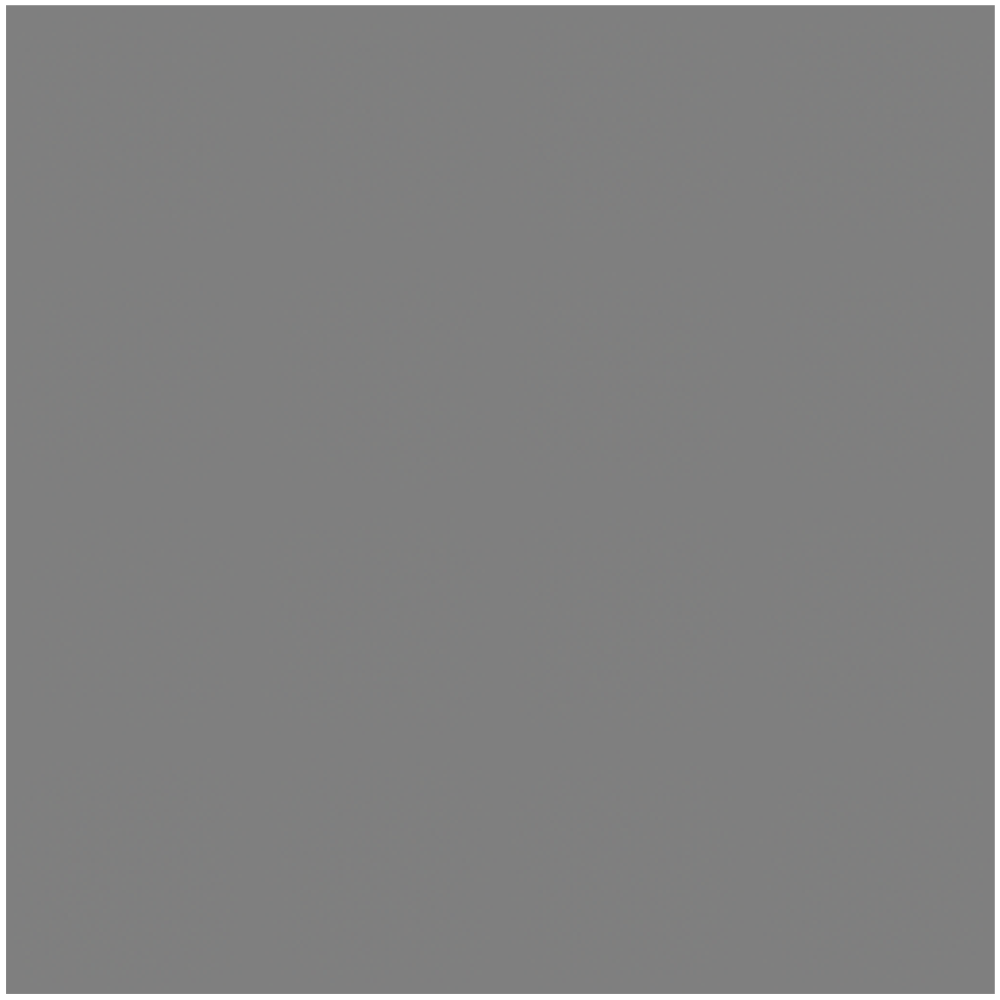

Disc: real loss: 0.810285 fake loss: 2.485449
GAN loss: 2.533369
Step 0 completed. Time took: 6 secs.
Begin step:  1
Disc: real loss: 1.183597 fake loss: 0.420528
GAN loss: 3.511470
Step 1 completed. Time took: 0 secs.
Begin step:  2
Disc: real loss: 0.765217 fake loss: 0.475714
GAN loss: 3.381035
Step 2 completed. Time took: 0 secs.
Begin step:  3
Disc: real loss: 0.403501 fake loss: 0.334268
GAN loss: 3.494876
Step 3 completed. Time took: 0 secs.
Begin step:  4
Disc: real loss: 0.655186 fake loss: 0.674121
GAN loss: 4.390656
Step 4 completed. Time took: 0 secs.
Begin step:  5
Disc: real loss: 0.756880 fake loss: 0.599734
GAN loss: 4.547729
Step 5 completed. Time took: 0 secs.
Begin step:  6
Disc: real loss: 0.617593 fake loss: 0.395580
GAN loss: 2.092957
Step 6 completed. Time took: 0 secs.
Begin step:  7
Disc: real loss: 0.396325 fake loss: 0.742736
GAN loss: 6.567941
Step 7 completed. Time took: 0 secs.
Begin step:  8
Disc: real loss: 1.332976 fake loss: 0.641978
GAN loss: 4.139603

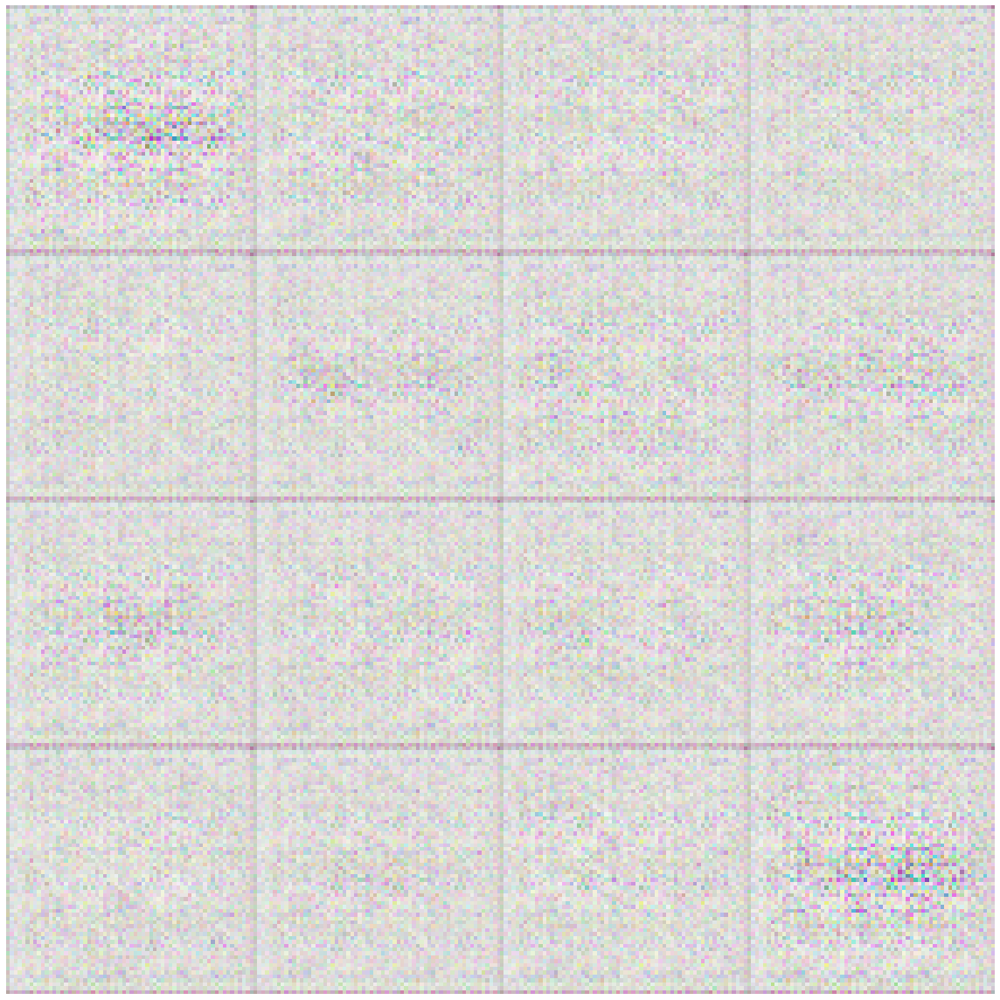

Disc: real loss: 0.430992 fake loss: 0.404999
GAN loss: 2.560834
Step 100 completed. Time took: 0 secs.
Begin step:  101
Disc: real loss: 0.387339 fake loss: 0.325056
GAN loss: 2.306858
Step 101 completed. Time took: 0 secs.
Begin step:  102
Disc: real loss: 0.393883 fake loss: 0.396541
GAN loss: 3.196701
Step 102 completed. Time took: 0 secs.
Begin step:  103
Disc: real loss: 0.424762 fake loss: 0.330536
GAN loss: 2.245773
Step 103 completed. Time took: 0 secs.
Begin step:  104
Disc: real loss: 0.378792 fake loss: 0.412020
GAN loss: 3.383794
Step 104 completed. Time took: 0 secs.
Begin step:  105
Disc: real loss: 0.437777 fake loss: 0.451731
GAN loss: 2.012806
Step 105 completed. Time took: 0 secs.
Begin step:  106
Disc: real loss: 0.412200 fake loss: 0.484631
GAN loss: 4.442327
Step 106 completed. Time took: 0 secs.
Begin step:  107
Disc: real loss: 0.522949 fake loss: 0.516868
GAN loss: 2.622315
Step 107 completed. Time took: 0 secs.
Begin step:  108
Disc: real loss: 0.340872 fake l

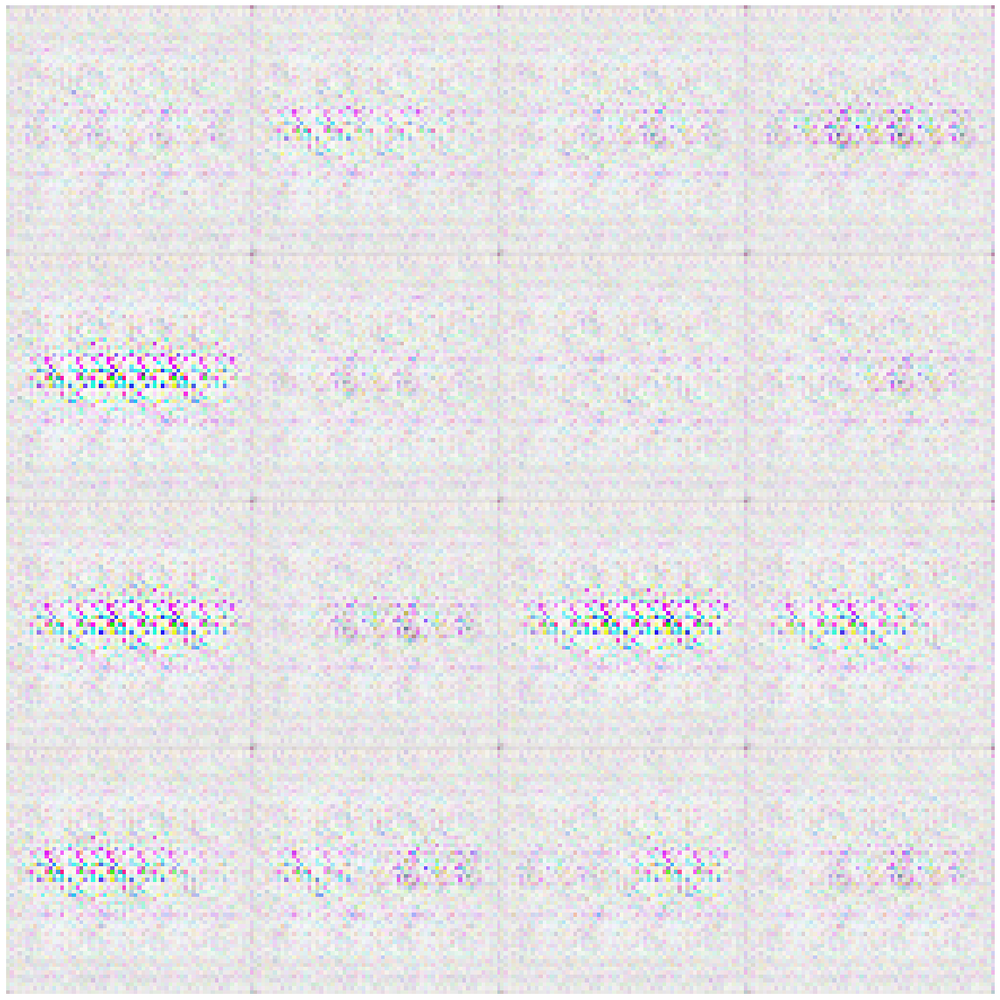

Disc: real loss: 0.392732 fake loss: 0.373116
GAN loss: 2.321408
Step 200 completed. Time took: 0 secs.
Begin step:  201
Disc: real loss: 0.348455 fake loss: 0.350517
GAN loss: 3.002477
Step 201 completed. Time took: 0 secs.
Begin step:  202
Disc: real loss: 0.333204 fake loss: 0.374250
GAN loss: 2.132534
Step 202 completed. Time took: 0 secs.
Begin step:  203
Disc: real loss: 0.389358 fake loss: 0.356661
GAN loss: 2.912395
Step 203 completed. Time took: 0 secs.
Begin step:  204
Disc: real loss: 0.395820 fake loss: 0.308467
GAN loss: 2.166306
Step 204 completed. Time took: 0 secs.
Begin step:  205
Disc: real loss: 0.358517 fake loss: 0.356336
GAN loss: 3.222130
Step 205 completed. Time took: 0 secs.
Begin step:  206
Disc: real loss: 0.351550 fake loss: 0.339915
GAN loss: 1.794025
Step 206 completed. Time took: 0 secs.
Begin step:  207
Disc: real loss: 0.351559 fake loss: 0.548617
GAN loss: 5.724627
Step 207 completed. Time took: 0 secs.
Begin step:  208
Disc: real loss: 0.706424 fake l

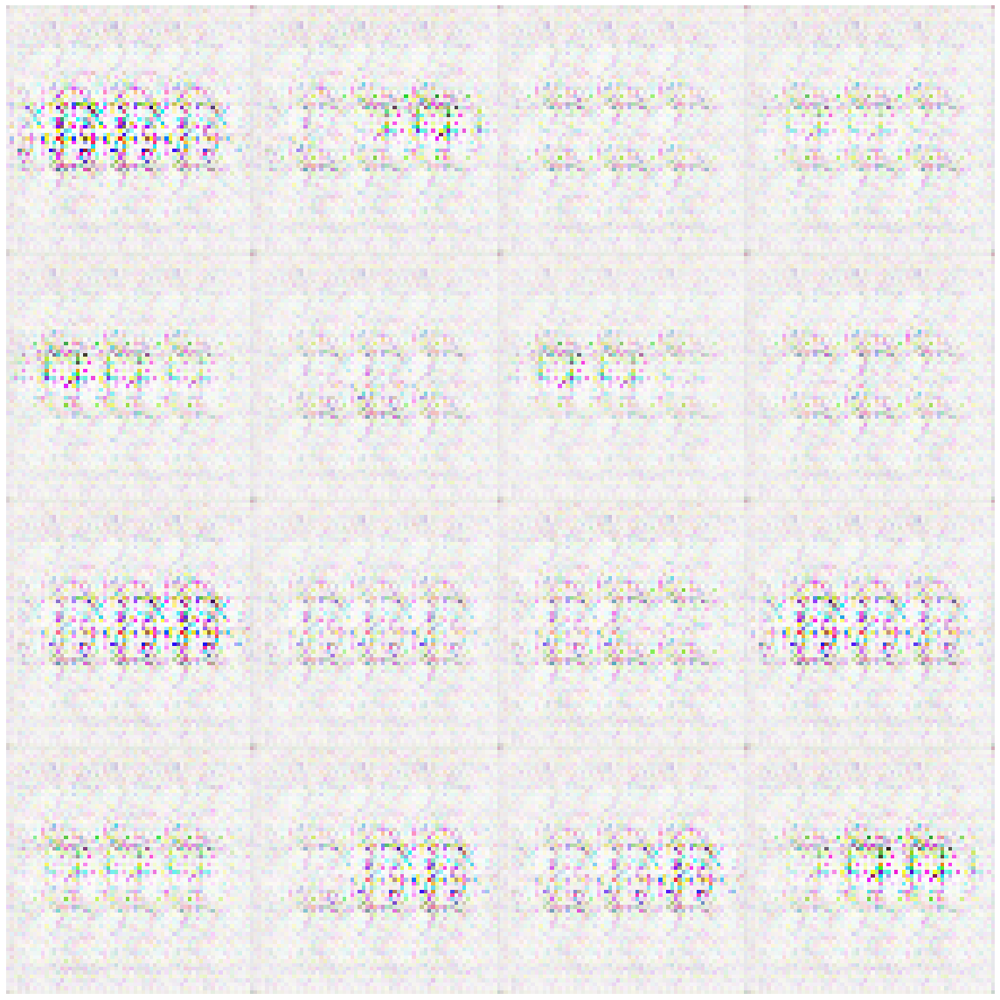

Disc: real loss: 0.337272 fake loss: 0.305652
GAN loss: 2.322857
Step 300 completed. Time took: 0 secs.
Begin step:  301
Disc: real loss: 0.345016 fake loss: 0.422324
GAN loss: 4.553408
Step 301 completed. Time took: 0 secs.
Begin step:  302
Disc: real loss: 0.488386 fake loss: 0.312185
GAN loss: 1.541569
Step 302 completed. Time took: 0 secs.
Begin step:  303
Disc: real loss: 0.469553 fake loss: 0.531852
GAN loss: 6.264062
Step 303 completed. Time took: 0 secs.
Begin step:  304
Disc: real loss: 0.458710 fake loss: 0.658123
GAN loss: 4.755893
Step 304 completed. Time took: 0 secs.
Begin step:  305
Disc: real loss: 0.375976 fake loss: 0.390495
GAN loss: 2.047611
Step 305 completed. Time took: 0 secs.
Begin step:  306
Disc: real loss: 0.359023 fake loss: 0.440855
GAN loss: 3.867725
Step 306 completed. Time took: 0 secs.
Begin step:  307
Disc: real loss: 0.379064 fake loss: 0.445944
GAN loss: 3.025850
Step 307 completed. Time took: 0 secs.
Begin step:  308
Disc: real loss: 0.332170 fake l

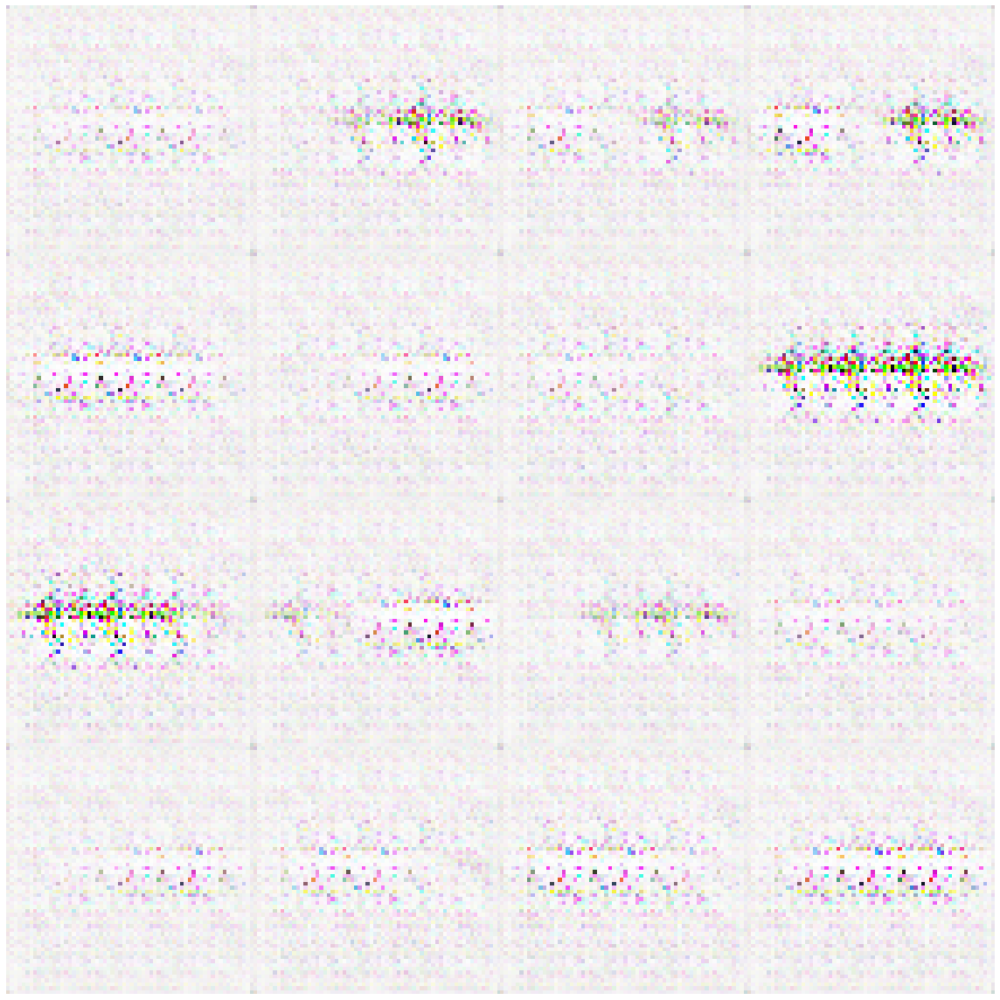

Disc: real loss: 0.355682 fake loss: 0.320182
GAN loss: 2.188057
Step 400 completed. Time took: 0 secs.
Begin step:  401
Disc: real loss: 0.323080 fake loss: 0.335207
GAN loss: 2.328036
Step 401 completed. Time took: 0 secs.
Begin step:  402
Disc: real loss: 0.381567 fake loss: 0.302509
GAN loss: 2.058165
Step 402 completed. Time took: 0 secs.
Begin step:  403
Disc: real loss: 0.387660 fake loss: 0.313533
GAN loss: 2.320156
Step 403 completed. Time took: 0 secs.
Begin step:  404
Disc: real loss: 0.360600 fake loss: 0.342374
GAN loss: 2.697958
Step 404 completed. Time took: 0 secs.
Begin step:  405
Disc: real loss: 0.359919 fake loss: 0.338486
GAN loss: 2.020059
Step 405 completed. Time took: 0 secs.
Begin step:  406
Disc: real loss: 0.328929 fake loss: 0.365263
GAN loss: 2.727731
Step 406 completed. Time took: 0 secs.
Begin step:  407
Disc: real loss: 0.353444 fake loss: 0.340140
GAN loss: 2.283912
Step 407 completed. Time took: 0 secs.
Begin step:  408
Disc: real loss: 0.349504 fake l

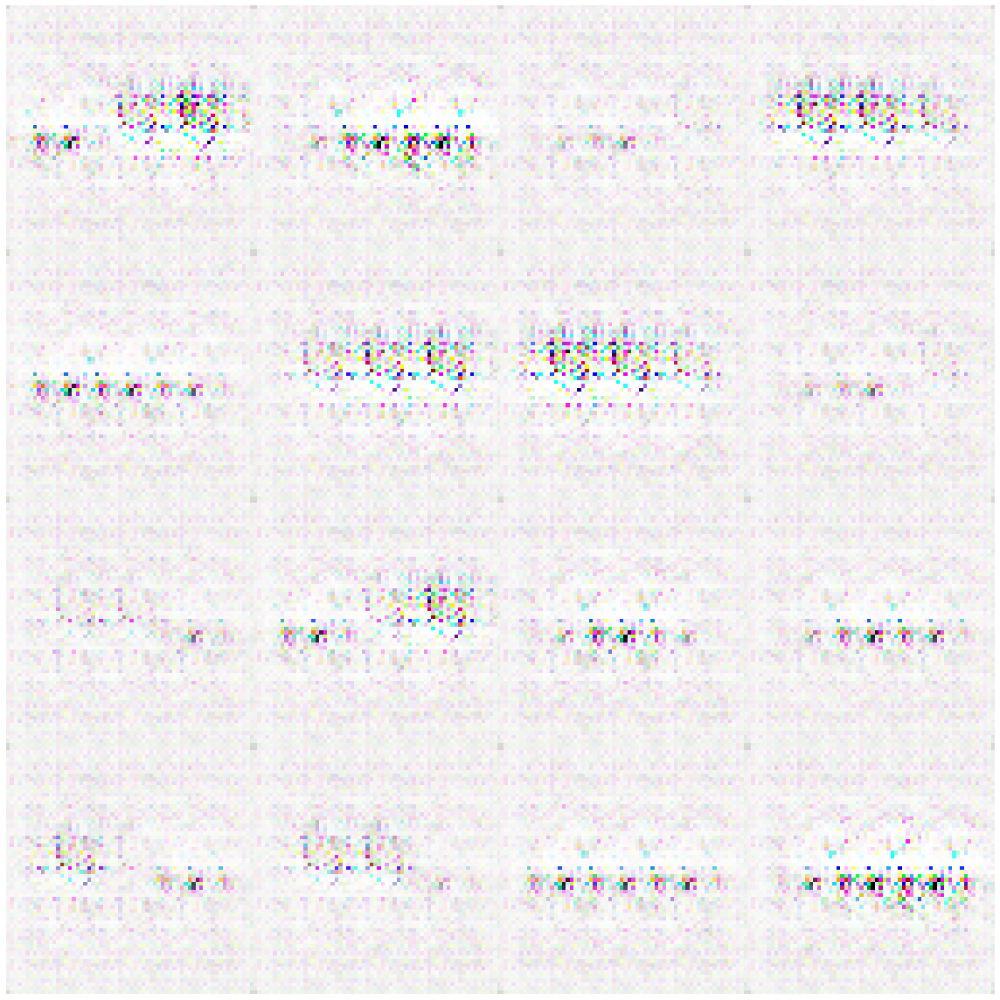

Begin step:  500


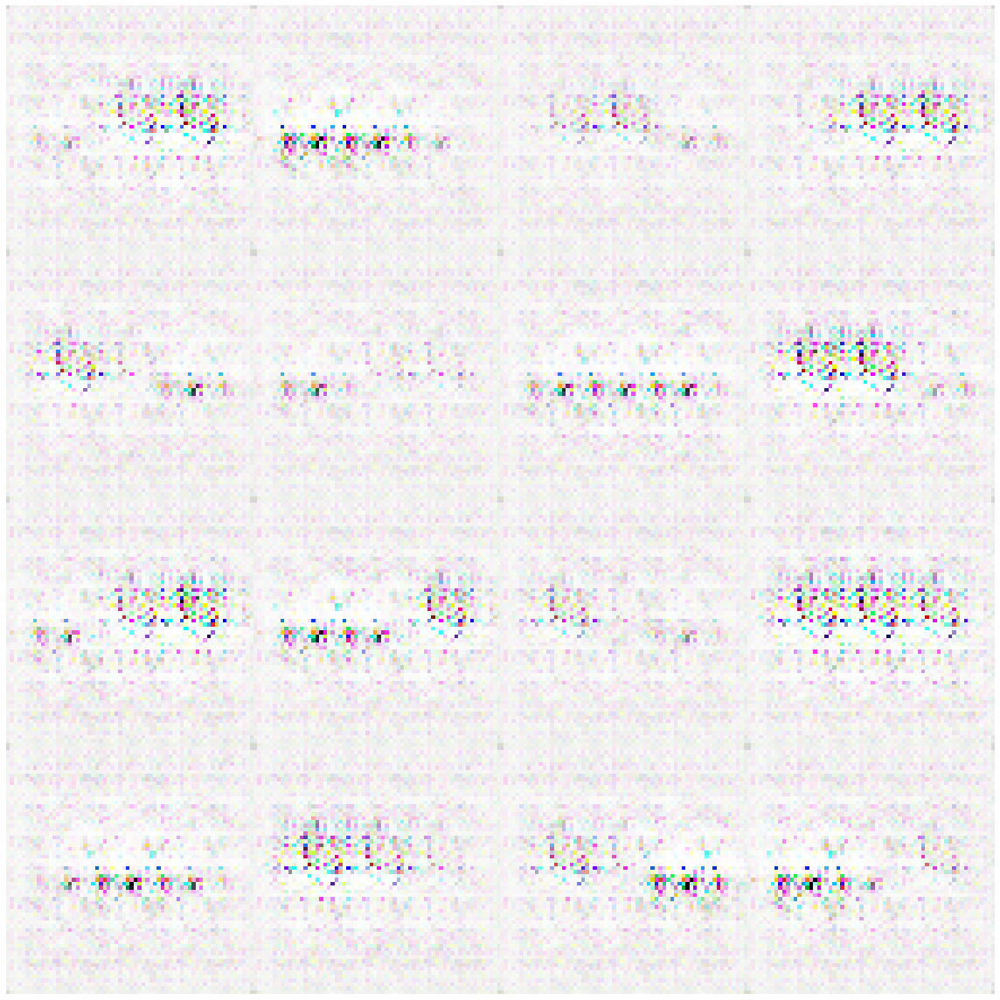

Disc: real loss: 0.355283 fake loss: 0.401759
GAN loss: 3.254296
Step 500 completed. Time took: 0 secs.
Begin step:  501
Disc: real loss: 0.369026 fake loss: 0.422059
GAN loss: 2.213867
Step 501 completed. Time took: 0 secs.
Begin step:  502
Disc: real loss: 0.316610 fake loss: 0.462035
GAN loss: 3.969815
Step 502 completed. Time took: 0 secs.
Begin step:  503
Disc: real loss: 0.378684 fake loss: 0.381113
GAN loss: 2.435596
Step 503 completed. Time took: 0 secs.
Begin step:  504
Disc: real loss: 0.337493 fake loss: 0.426352
GAN loss: 3.582878
Step 504 completed. Time took: 0 secs.
Begin step:  505
Disc: real loss: 0.352950 fake loss: 0.497912
GAN loss: 2.763244
Step 505 completed. Time took: 0 secs.
Begin step:  506
Disc: real loss: 0.329322 fake loss: 0.432635
GAN loss: 3.134002
Step 506 completed. Time took: 0 secs.
Begin step:  507
Disc: real loss: 0.327465 fake loss: 0.401300
GAN loss: 2.302258
Step 507 completed. Time took: 0 secs.
Begin step:  508
Disc: real loss: 0.347788 fake l

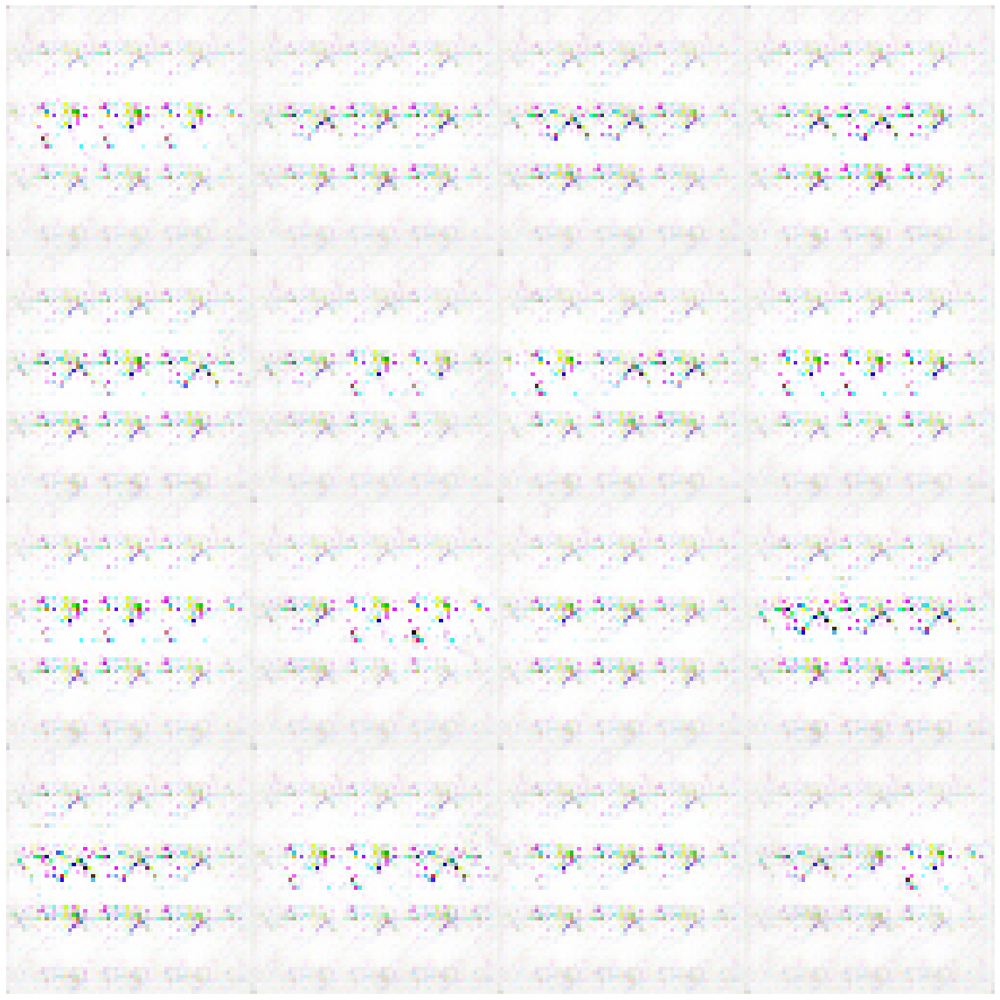

Disc: real loss: 0.450591 fake loss: 0.490220
GAN loss: 2.756570
Step 600 completed. Time took: 0 secs.
Begin step:  601
Disc: real loss: 0.367062 fake loss: 0.401190
GAN loss: 2.707667
Step 601 completed. Time took: 0 secs.
Begin step:  602
Disc: real loss: 0.365959 fake loss: 0.386717
GAN loss: 2.489223
Step 602 completed. Time took: 0 secs.
Begin step:  603
Disc: real loss: 0.332487 fake loss: 0.351710
GAN loss: 2.578676
Step 603 completed. Time took: 0 secs.
Begin step:  604
Disc: real loss: 0.366403 fake loss: 0.331053
GAN loss: 2.204816
Step 604 completed. Time took: 0 secs.
Begin step:  605
Disc: real loss: 0.305994 fake loss: 0.386049
GAN loss: 3.184752
Step 605 completed. Time took: 0 secs.
Begin step:  606
Disc: real loss: 0.335823 fake loss: 0.339095
GAN loss: 2.256322
Step 606 completed. Time took: 0 secs.
Begin step:  607
Disc: real loss: 0.356301 fake loss: 0.393807
GAN loss: 3.457104
Step 607 completed. Time took: 0 secs.
Begin step:  608
Disc: real loss: 0.324174 fake l

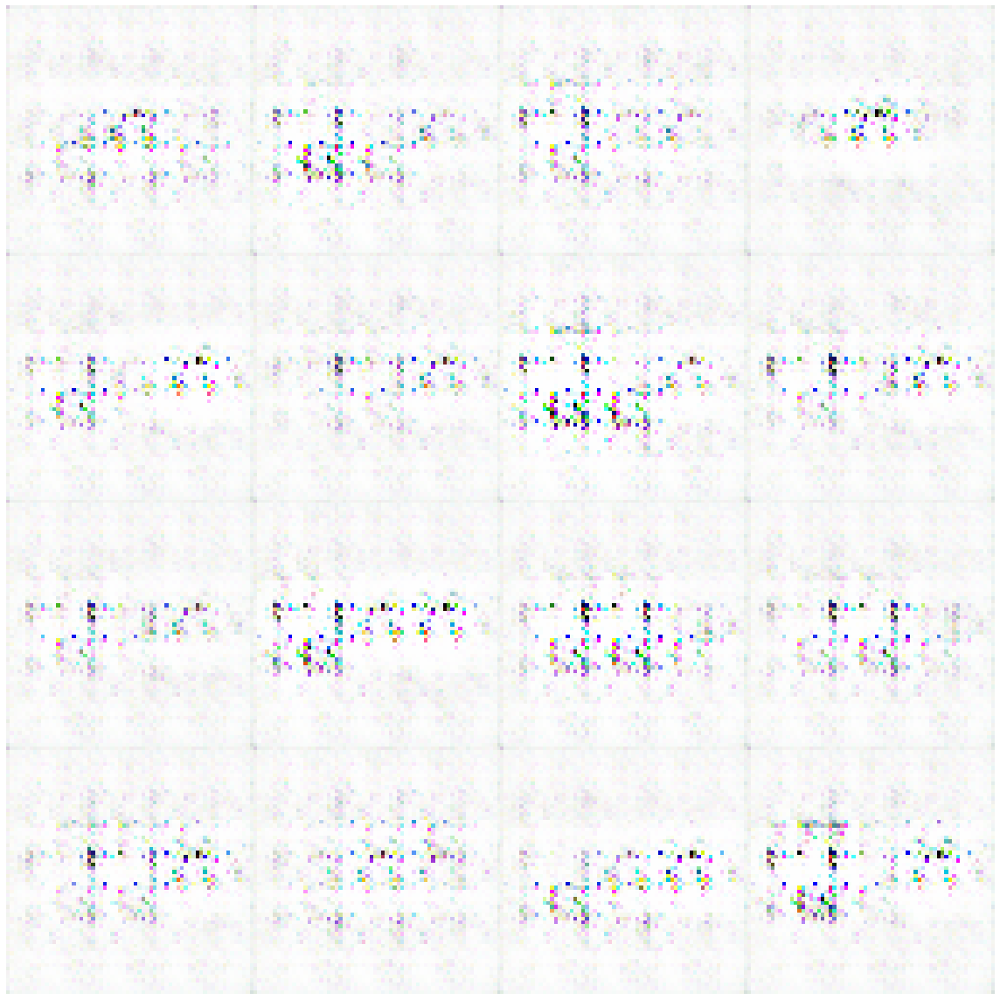

Disc: real loss: 0.342169 fake loss: 0.372667
GAN loss: 3.009582
Step 700 completed. Time took: 0 secs.
Begin step:  701
Disc: real loss: 0.374978 fake loss: 0.337645
GAN loss: 1.871960
Step 701 completed. Time took: 0 secs.
Begin step:  702
Disc: real loss: 0.357122 fake loss: 0.478320
GAN loss: 4.818976
Step 702 completed. Time took: 0 secs.
Begin step:  703
Disc: real loss: 0.472914 fake loss: 0.479931
GAN loss: 2.808366
Step 703 completed. Time took: 0 secs.
Begin step:  704
Disc: real loss: 0.356043 fake loss: 0.369560
GAN loss: 3.294046
Step 704 completed. Time took: 0 secs.
Begin step:  705
Disc: real loss: 0.360330 fake loss: 0.321275
GAN loss: 2.645594
Step 705 completed. Time took: 0 secs.
Begin step:  706
Disc: real loss: 0.323871 fake loss: 0.428967
GAN loss: 3.740412
Step 706 completed. Time took: 0 secs.
Begin step:  707
Disc: real loss: 0.445321 fake loss: 0.367839
GAN loss: 1.815213
Step 707 completed. Time took: 0 secs.
Begin step:  708
Disc: real loss: 0.356534 fake l

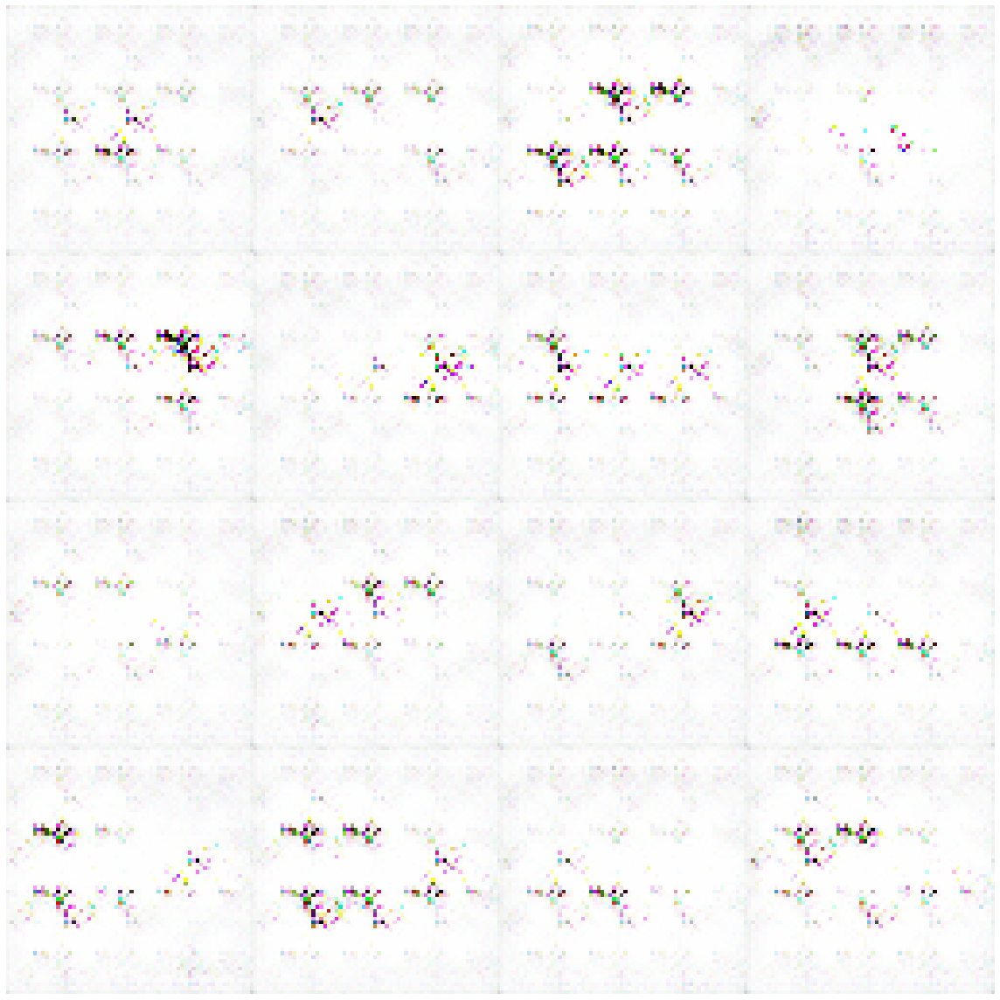

Disc: real loss: 0.359224 fake loss: 0.397322
GAN loss: 2.730928
Step 800 completed. Time took: 0 secs.
Begin step:  801
Disc: real loss: 0.369444 fake loss: 0.333330
GAN loss: 2.539610
Step 801 completed. Time took: 0 secs.
Begin step:  802
Disc: real loss: 0.376861 fake loss: 0.445352
GAN loss: 3.177922
Step 802 completed. Time took: 0 secs.
Begin step:  803
Disc: real loss: 0.402757 fake loss: 0.360724
GAN loss: 2.123448
Step 803 completed. Time took: 0 secs.
Begin step:  804
Disc: real loss: 0.336499 fake loss: 0.416430
GAN loss: 3.009385
Step 804 completed. Time took: 0 secs.
Begin step:  805
Disc: real loss: 0.325751 fake loss: 0.367774
GAN loss: 2.631592
Step 805 completed. Time took: 0 secs.
Begin step:  806
Disc: real loss: 0.361279 fake loss: 0.424439
GAN loss: 2.954150
Step 806 completed. Time took: 0 secs.
Begin step:  807
Disc: real loss: 0.417946 fake loss: 0.313253
GAN loss: 2.478022
Step 807 completed. Time took: 0 secs.
Begin step:  808
Disc: real loss: 0.320166 fake l

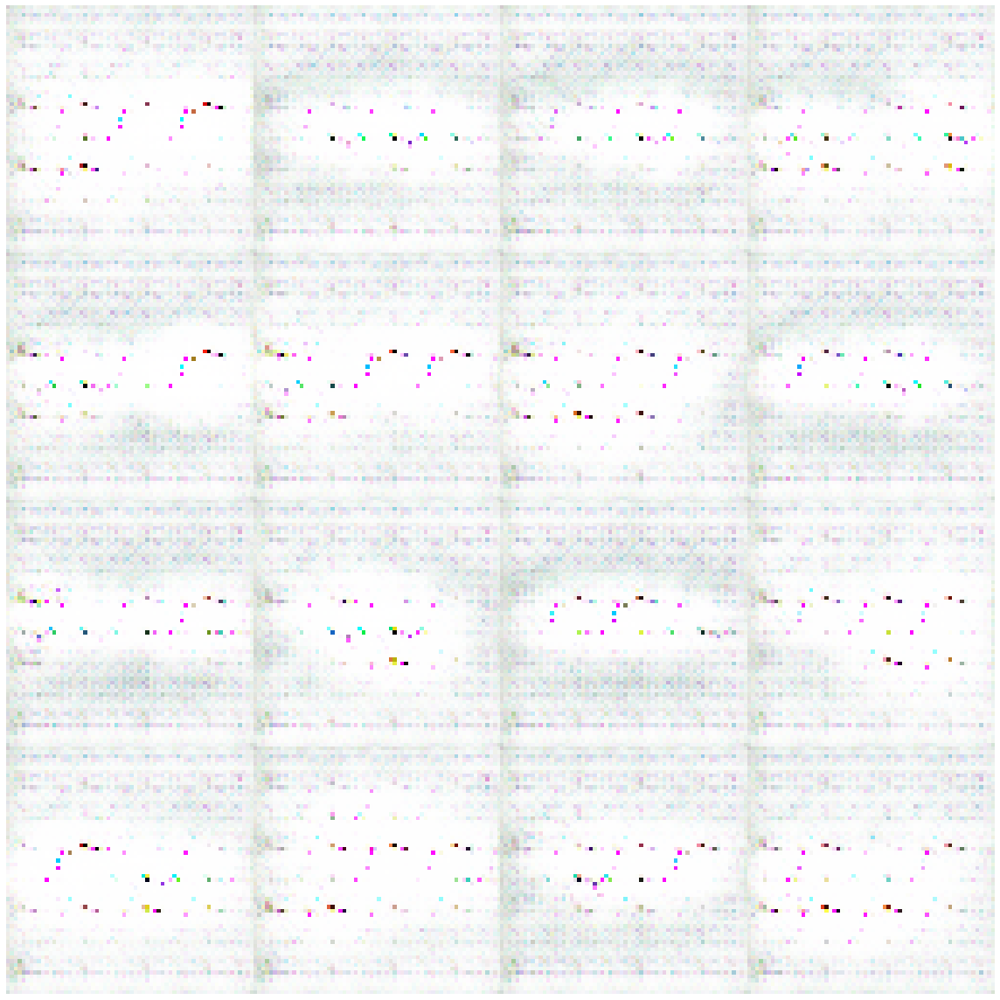

Disc: real loss: 0.336742 fake loss: 0.363944
GAN loss: 2.627079
Step 900 completed. Time took: 0 secs.
Begin step:  901
Disc: real loss: 0.338827 fake loss: 0.320919
GAN loss: 2.309655
Step 901 completed. Time took: 0 secs.
Begin step:  902
Disc: real loss: 0.334683 fake loss: 0.378362
GAN loss: 3.013926
Step 902 completed. Time took: 0 secs.
Begin step:  903
Disc: real loss: 0.326172 fake loss: 0.353361
GAN loss: 2.195882
Step 903 completed. Time took: 0 secs.
Begin step:  904
Disc: real loss: 0.326627 fake loss: 0.382785
GAN loss: 3.263199
Step 904 completed. Time took: 0 secs.
Begin step:  905
Disc: real loss: 0.395739 fake loss: 0.383616
GAN loss: 1.938915
Step 905 completed. Time took: 0 secs.
Begin step:  906
Disc: real loss: 0.364309 fake loss: 0.369852
GAN loss: 3.255575
Step 906 completed. Time took: 0 secs.
Begin step:  907
Disc: real loss: 0.365041 fake loss: 0.384445
GAN loss: 2.604994
Step 907 completed. Time took: 0 secs.
Begin step:  908
Disc: real loss: 0.325922 fake l

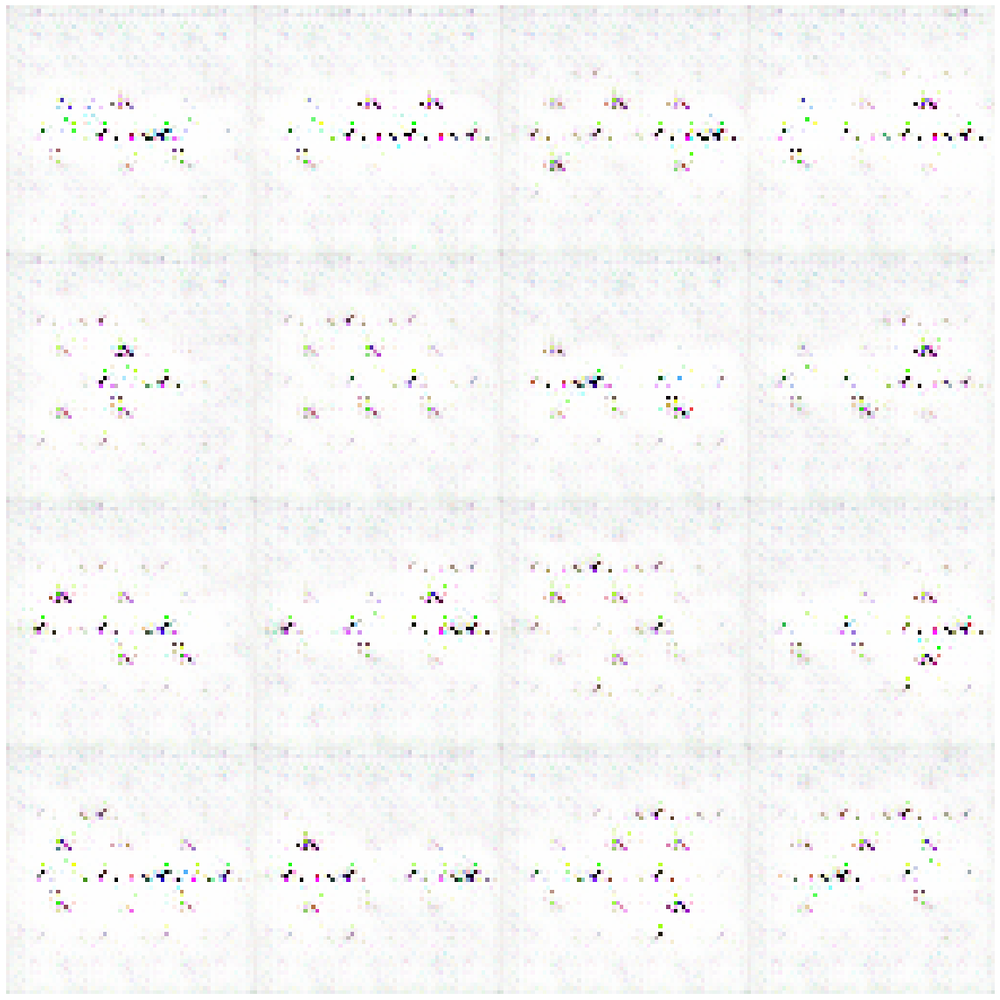

Begin step:  1000


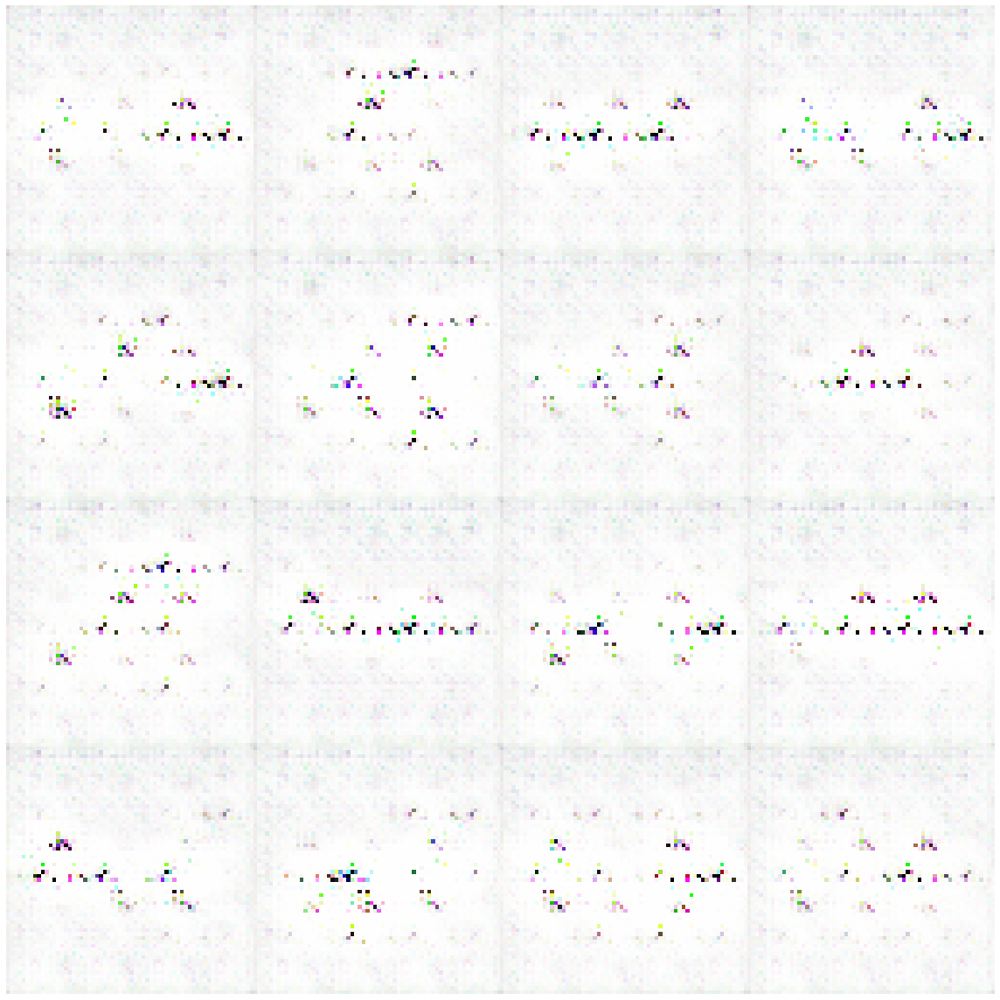

Disc: real loss: 0.405116 fake loss: 0.386390
GAN loss: 2.010282
Step 1000 completed. Time took: 0 secs.
Begin step:  1001
Disc: real loss: 0.331485 fake loss: 0.473505
GAN loss: 3.938748
Step 1001 completed. Time took: 0 secs.
Begin step:  1002
Disc: real loss: 0.370847 fake loss: 0.539251
GAN loss: 3.335148
Step 1002 completed. Time took: 0 secs.
Begin step:  1003
Disc: real loss: 0.355331 fake loss: 0.303455
GAN loss: 2.253038
Step 1003 completed. Time took: 0 secs.
Begin step:  1004
Disc: real loss: 0.376543 fake loss: 0.390673
GAN loss: 2.871536
Step 1004 completed. Time took: 0 secs.
Begin step:  1005
Disc: real loss: 0.356921 fake loss: 0.331877
GAN loss: 2.145807
Step 1005 completed. Time took: 0 secs.
Begin step:  1006
Disc: real loss: 0.327824 fake loss: 0.424099
GAN loss: 4.448836
Step 1006 completed. Time took: 0 secs.
Begin step:  1007
Disc: real loss: 0.467331 fake loss: 0.421337
GAN loss: 2.570907
Step 1007 completed. Time took: 0 secs.
Begin step:  1008
Disc: real loss:

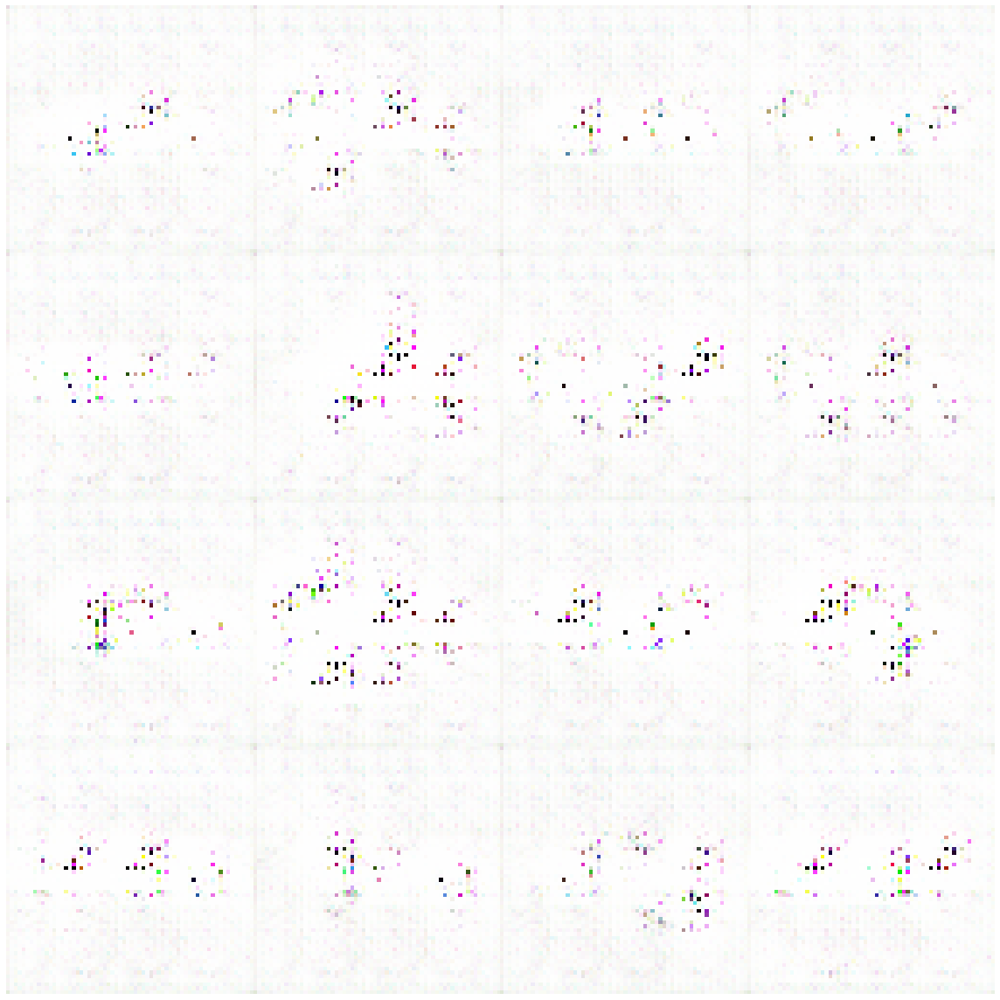

Disc: real loss: 0.688803 fake loss: 0.546368
GAN loss: 3.435658
Step 1100 completed. Time took: 0 secs.
Begin step:  1101
Disc: real loss: 0.396406 fake loss: 0.394227
GAN loss: 2.219456
Step 1101 completed. Time took: 0 secs.
Begin step:  1102
Disc: real loss: 0.408228 fake loss: 0.373511
GAN loss: 2.656183
Step 1102 completed. Time took: 0 secs.
Begin step:  1103
Disc: real loss: 0.313977 fake loss: 0.349093
GAN loss: 2.278196
Step 1103 completed. Time took: 0 secs.
Begin step:  1104
Disc: real loss: 0.366550 fake loss: 0.373646
GAN loss: 2.748972
Step 1104 completed. Time took: 0 secs.
Begin step:  1105
Disc: real loss: 0.363796 fake loss: 0.345176
GAN loss: 2.226468
Step 1105 completed. Time took: 0 secs.
Begin step:  1106
Disc: real loss: 0.402473 fake loss: 0.361751
GAN loss: 2.943196
Step 1106 completed. Time took: 0 secs.
Begin step:  1107
Disc: real loss: 0.358696 fake loss: 0.353237
GAN loss: 2.152990
Step 1107 completed. Time took: 0 secs.
Begin step:  1108
Disc: real loss:

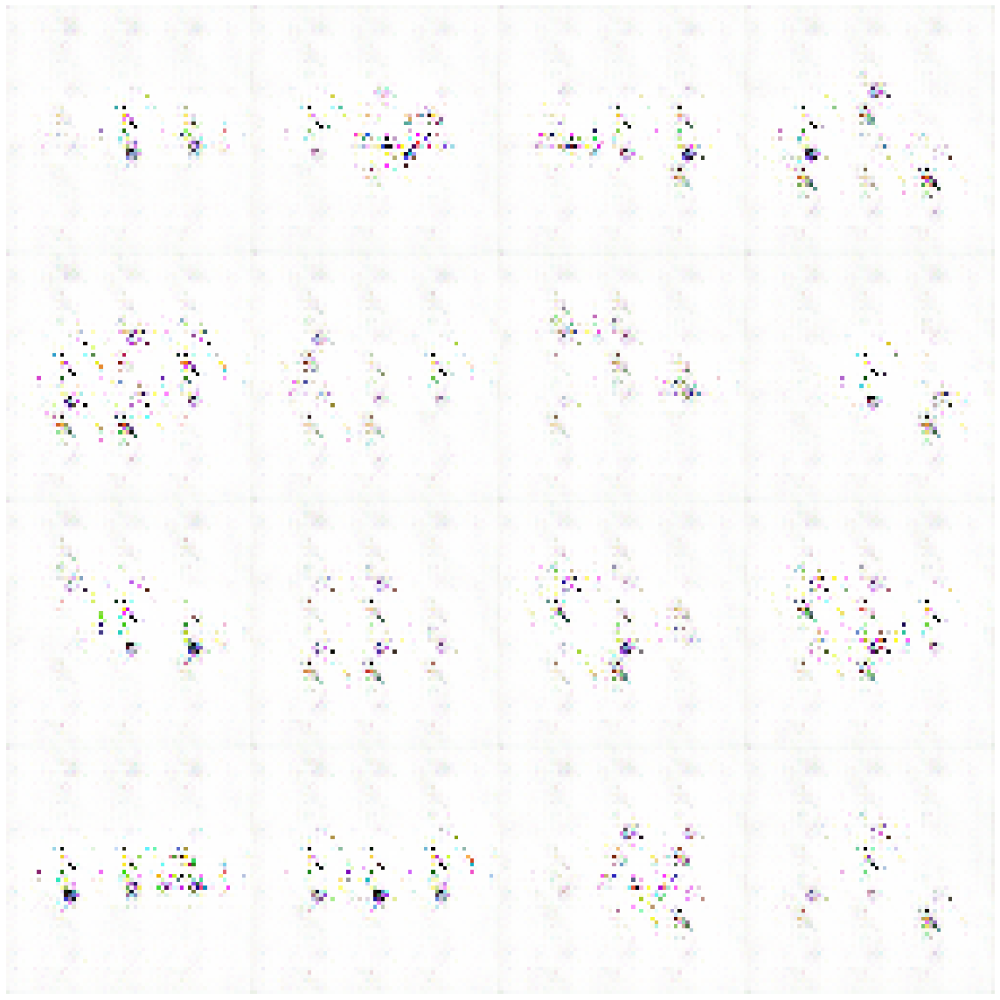

Disc: real loss: 0.417701 fake loss: 0.399363
GAN loss: 2.696956
Step 1200 completed. Time took: 0 secs.
Begin step:  1201
Disc: real loss: 0.353565 fake loss: 0.324325
GAN loss: 2.613523
Step 1201 completed. Time took: 0 secs.
Begin step:  1202
Disc: real loss: 0.401336 fake loss: 0.441138
GAN loss: 3.791757
Step 1202 completed. Time took: 0 secs.
Begin step:  1203
Disc: real loss: 0.397485 fake loss: 0.433237
GAN loss: 3.105719
Step 1203 completed. Time took: 0 secs.
Begin step:  1204
Disc: real loss: 0.355648 fake loss: 0.324845
GAN loss: 2.219526
Step 1204 completed. Time took: 0 secs.
Begin step:  1205
Disc: real loss: 0.332426 fake loss: 0.346106
GAN loss: 2.654689
Step 1205 completed. Time took: 0 secs.
Begin step:  1206
Disc: real loss: 0.348968 fake loss: 0.329445
GAN loss: 2.492866
Step 1206 completed. Time took: 0 secs.
Begin step:  1207
Disc: real loss: 0.322499 fake loss: 0.321079
GAN loss: 2.526337
Step 1207 completed. Time took: 0 secs.
Begin step:  1208
Disc: real loss:

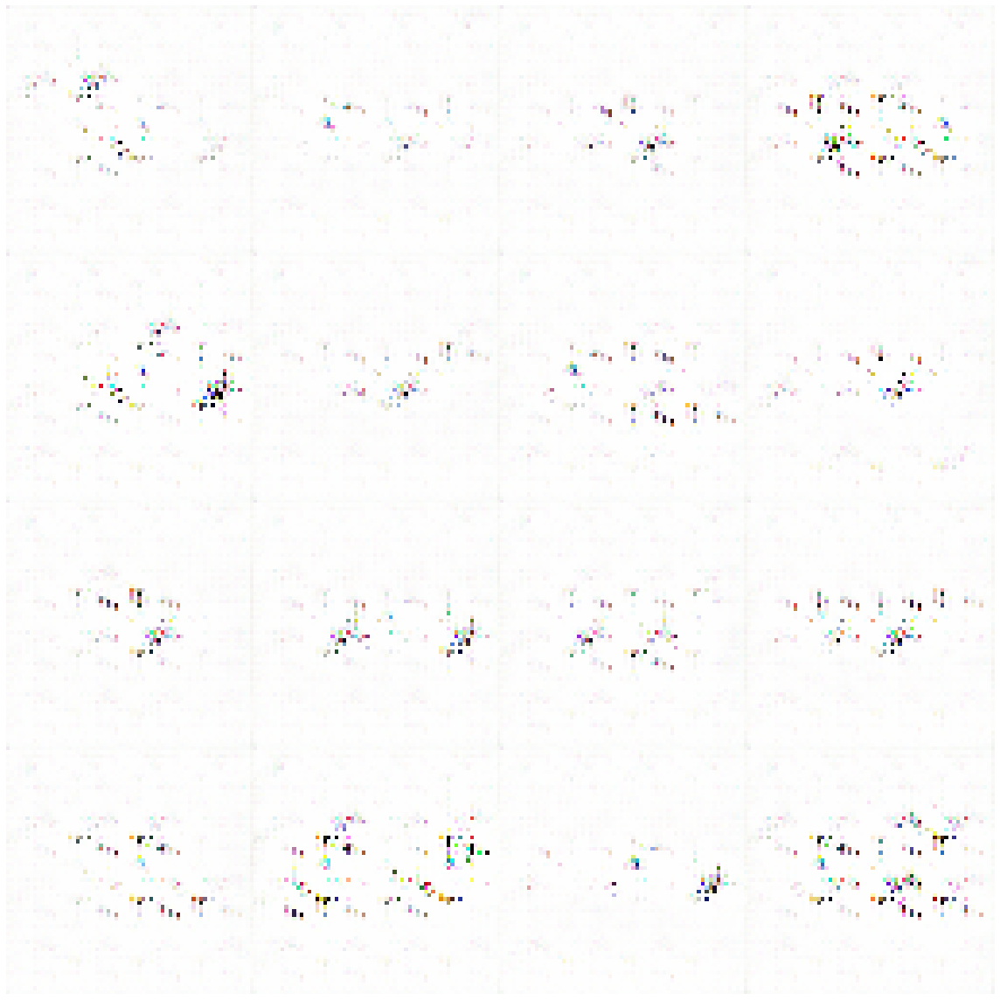

Disc: real loss: 0.511802 fake loss: 0.743632
GAN loss: 5.367174
Step 1300 completed. Time took: 0 secs.
Begin step:  1301
Disc: real loss: 0.448634 fake loss: 0.636463
GAN loss: 5.003274
Step 1301 completed. Time took: 0 secs.
Begin step:  1302
Disc: real loss: 0.337123 fake loss: 0.442191
GAN loss: 2.583279
Step 1302 completed. Time took: 0 secs.
Begin step:  1303
Disc: real loss: 0.394330 fake loss: 0.366011
GAN loss: 2.796546
Step 1303 completed. Time took: 0 secs.
Begin step:  1304
Disc: real loss: 0.325505 fake loss: 0.357649
GAN loss: 2.500109
Step 1304 completed. Time took: 0 secs.
Begin step:  1305
Disc: real loss: 0.356599 fake loss: 0.344762
GAN loss: 2.504035
Step 1305 completed. Time took: 0 secs.
Begin step:  1306
Disc: real loss: 0.350698 fake loss: 0.332440
GAN loss: 2.410418
Step 1306 completed. Time took: 0 secs.
Begin step:  1307
Disc: real loss: 0.353897 fake loss: 0.369484
GAN loss: 2.712659
Step 1307 completed. Time took: 0 secs.
Begin step:  1308
Disc: real loss:

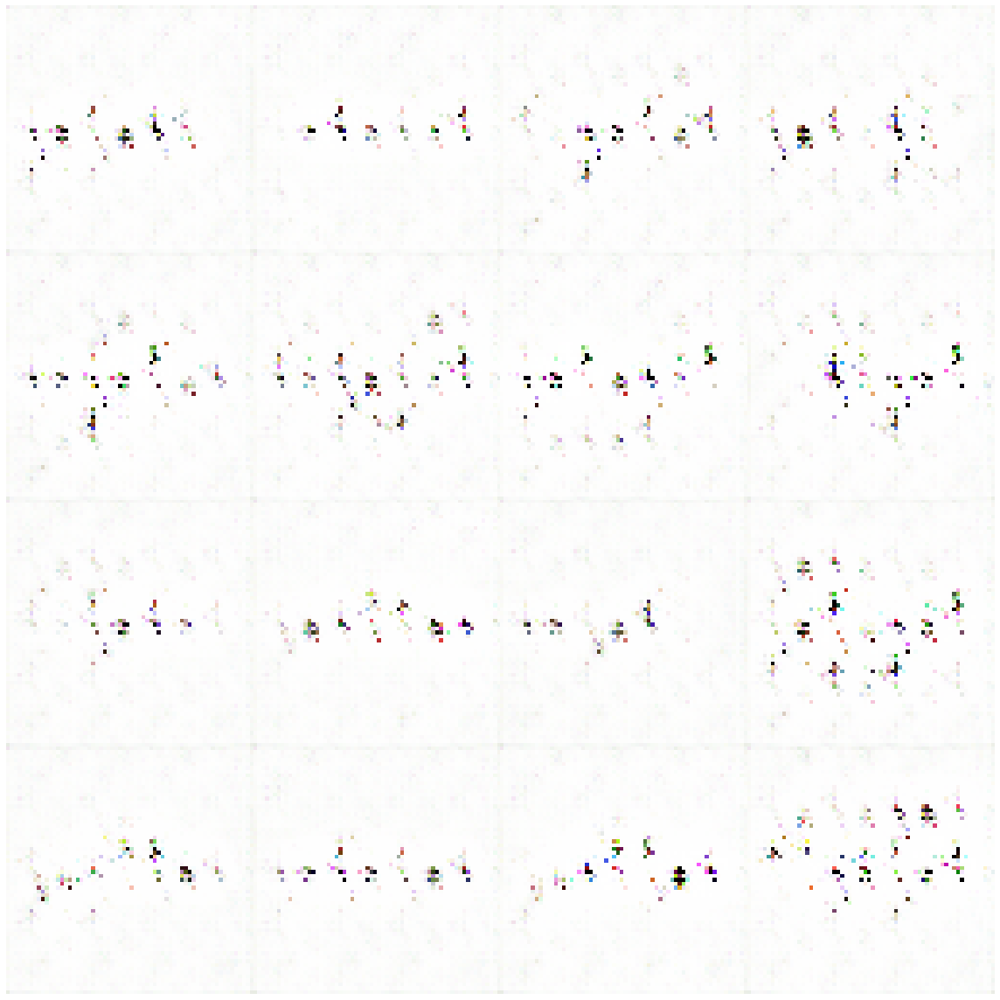

Disc: real loss: 0.354464 fake loss: 0.510822
GAN loss: 4.812244
Step 1400 completed. Time took: 0 secs.
Begin step:  1401
Disc: real loss: 0.686542 fake loss: 0.429679
GAN loss: 2.031856
Step 1401 completed. Time took: 0 secs.
Begin step:  1402
Disc: real loss: 0.452682 fake loss: 0.496879
GAN loss: 3.966767
Step 1402 completed. Time took: 0 secs.
Begin step:  1403
Disc: real loss: 0.343295 fake loss: 0.513865
GAN loss: 3.902692
Step 1403 completed. Time took: 0 secs.
Begin step:  1404
Disc: real loss: 0.372587 fake loss: 0.354741
GAN loss: 1.794963
Step 1404 completed. Time took: 0 secs.
Begin step:  1405
Disc: real loss: 0.363352 fake loss: 0.478642
GAN loss: 3.482609
Step 1405 completed. Time took: 0 secs.
Begin step:  1406
Disc: real loss: 0.385194 fake loss: 0.394236
GAN loss: 2.852986
Step 1406 completed. Time took: 0 secs.
Begin step:  1407
Disc: real loss: 0.344891 fake loss: 0.391621
GAN loss: 2.468119
Step 1407 completed. Time took: 0 secs.
Begin step:  1408
Disc: real loss:

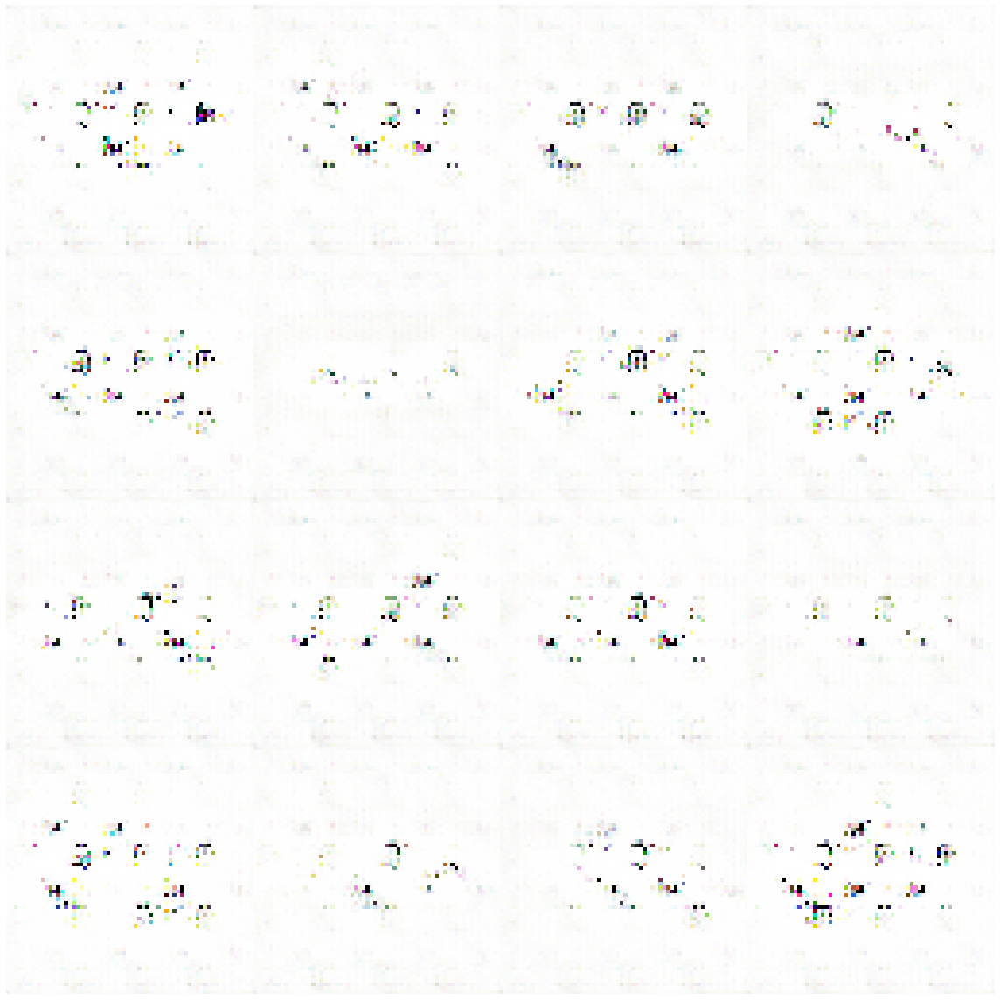

Begin step:  1500


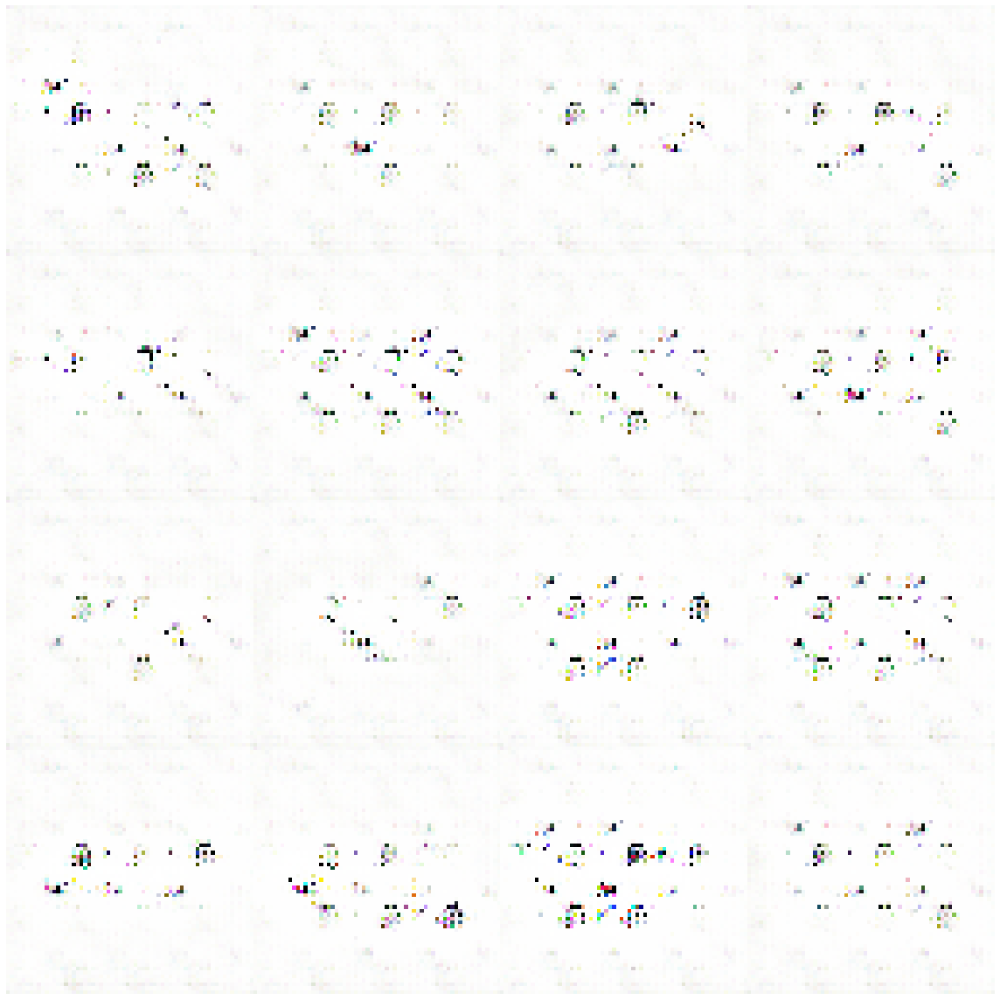

Disc: real loss: 0.363675 fake loss: 0.375864
GAN loss: 3.239068
Step 1500 completed. Time took: 0 secs.
Begin step:  1501
Disc: real loss: 0.403816 fake loss: 0.337767
GAN loss: 2.092906
Step 1501 completed. Time took: 0 secs.
Begin step:  1502
Disc: real loss: 0.358202 fake loss: 0.489477
GAN loss: 4.378416
Step 1502 completed. Time took: 0 secs.
Begin step:  1503
Disc: real loss: 0.616793 fake loss: 0.387578
GAN loss: 1.749393
Step 1503 completed. Time took: 0 secs.
Begin step:  1504
Disc: real loss: 0.413430 fake loss: 0.637867
GAN loss: 5.040848
Step 1504 completed. Time took: 0 secs.
Begin step:  1505
Disc: real loss: 0.485734 fake loss: 0.542216
GAN loss: 4.594038
Step 1505 completed. Time took: 0 secs.
Begin step:  1506
Disc: real loss: 0.371346 fake loss: 0.373707
GAN loss: 2.702621
Step 1506 completed. Time took: 0 secs.
Begin step:  1507
Disc: real loss: 0.353101 fake loss: 0.392795
GAN loss: 2.411641
Step 1507 completed. Time took: 0 secs.
Begin step:  1508
Disc: real loss:

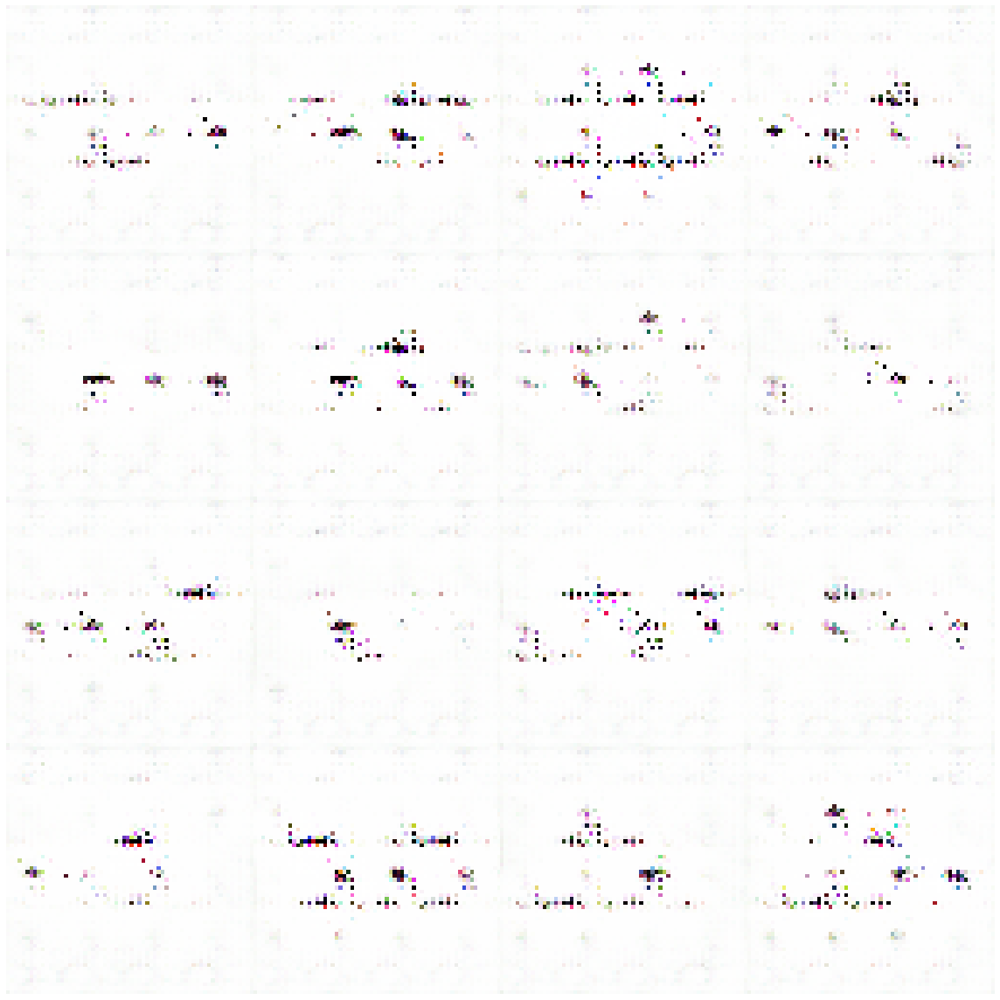

Disc: real loss: 0.570823 fake loss: 0.349975
GAN loss: 1.991958
Step 1600 completed. Time took: 0 secs.
Begin step:  1601
Disc: real loss: 0.414819 fake loss: 0.354600
GAN loss: 2.881773
Step 1601 completed. Time took: 0 secs.
Begin step:  1602
Disc: real loss: 0.335552 fake loss: 0.338448
GAN loss: 2.574496
Step 1602 completed. Time took: 0 secs.
Begin step:  1603
Disc: real loss: 0.309353 fake loss: 0.349535
GAN loss: 2.766657
Step 1603 completed. Time took: 0 secs.
Begin step:  1604
Disc: real loss: 0.378441 fake loss: 0.329249
GAN loss: 2.288896
Step 1604 completed. Time took: 0 secs.
Begin step:  1605
Disc: real loss: 0.337054 fake loss: 0.354877
GAN loss: 2.736603
Step 1605 completed. Time took: 0 secs.
Begin step:  1606
Disc: real loss: 0.353330 fake loss: 0.342045
GAN loss: 2.420448
Step 1606 completed. Time took: 0 secs.
Begin step:  1607
Disc: real loss: 0.354512 fake loss: 0.363053
GAN loss: 3.397245
Step 1607 completed. Time took: 0 secs.
Begin step:  1608
Disc: real loss:

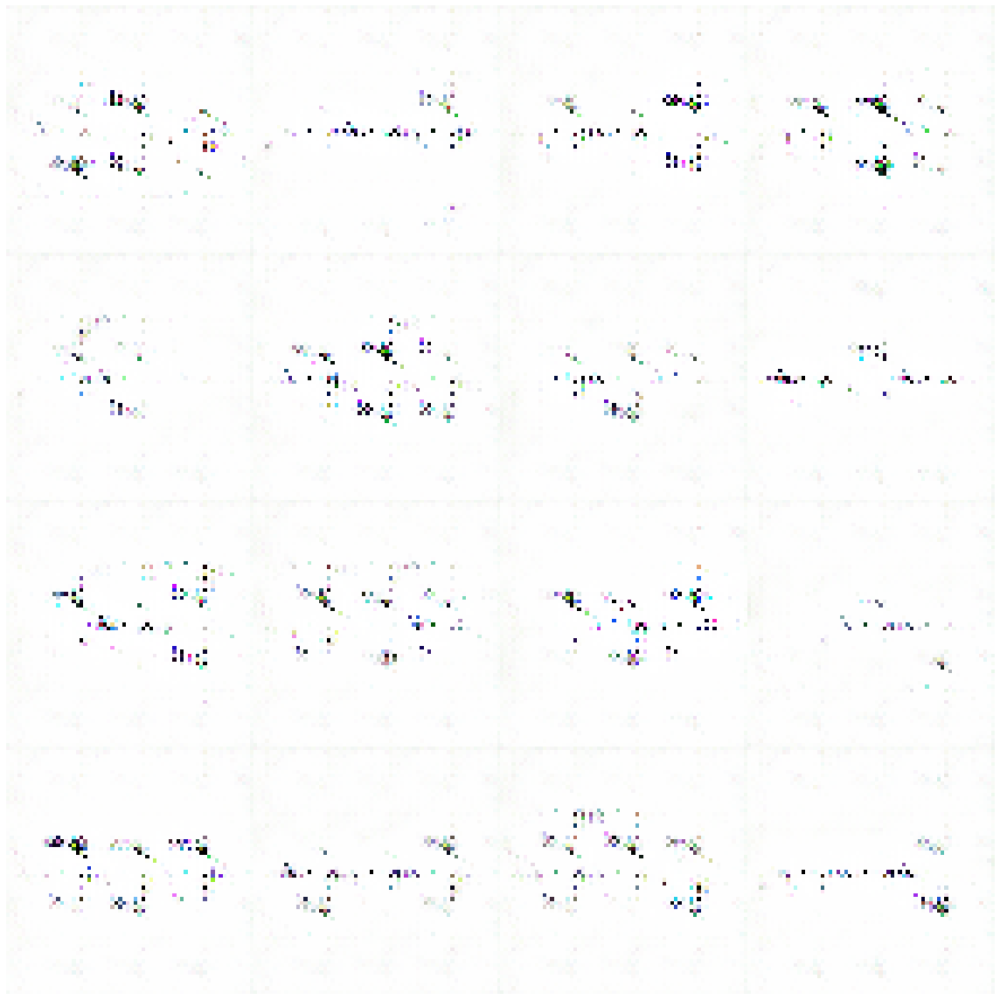

Disc: real loss: 0.416382 fake loss: 0.371066
GAN loss: 2.106064
Step 1700 completed. Time took: 0 secs.
Begin step:  1701
Disc: real loss: 0.318800 fake loss: 0.443132
GAN loss: 3.562737
Step 1701 completed. Time took: 0 secs.
Begin step:  1702
Disc: real loss: 0.419420 fake loss: 0.364504
GAN loss: 2.254120
Step 1702 completed. Time took: 0 secs.
Begin step:  1703
Disc: real loss: 0.315325 fake loss: 0.447875
GAN loss: 3.260259
Step 1703 completed. Time took: 0 secs.
Begin step:  1704
Disc: real loss: 0.385608 fake loss: 0.354088
GAN loss: 2.441039
Step 1704 completed. Time took: 0 secs.
Begin step:  1705
Disc: real loss: 0.343452 fake loss: 0.379137
GAN loss: 3.260725
Step 1705 completed. Time took: 0 secs.
Begin step:  1706
Disc: real loss: 0.413154 fake loss: 0.325625
GAN loss: 2.140822
Step 1706 completed. Time took: 0 secs.
Begin step:  1707
Disc: real loss: 0.354169 fake loss: 0.383124
GAN loss: 3.599899
Step 1707 completed. Time took: 0 secs.
Begin step:  1708
Disc: real loss:

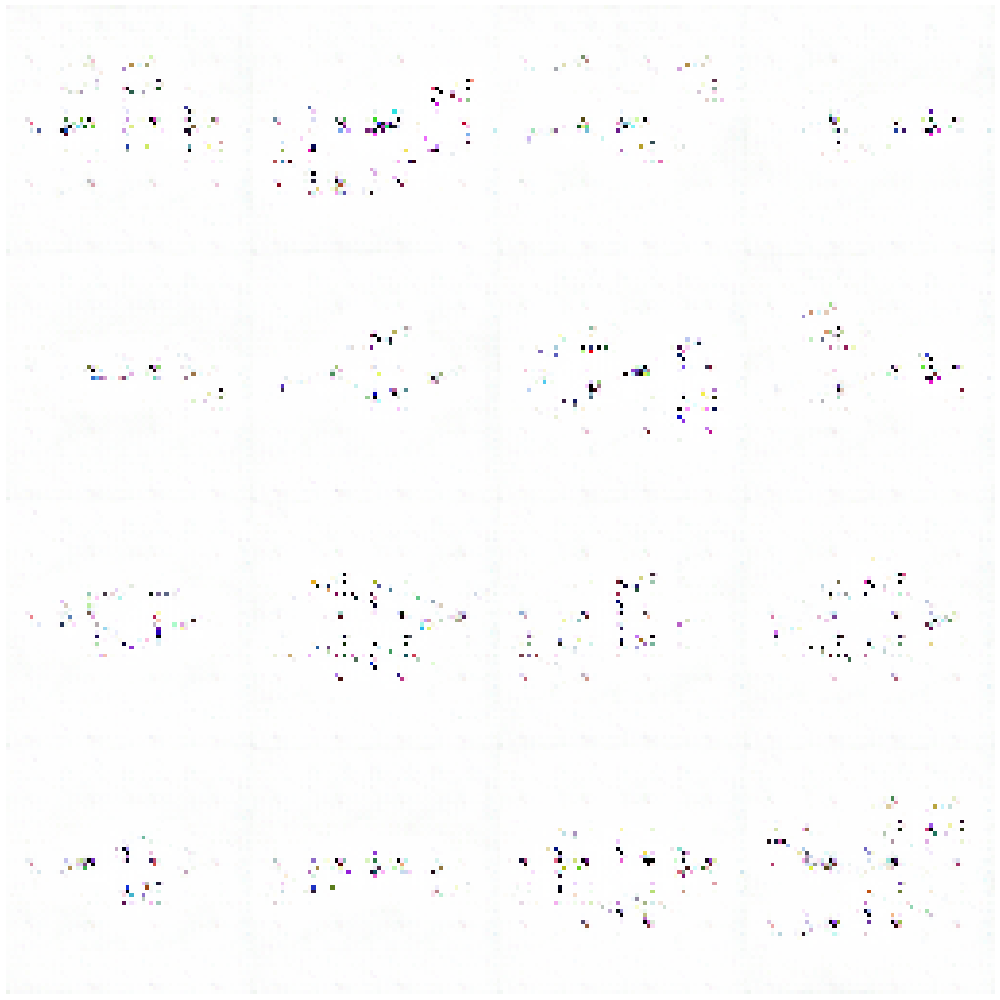

Disc: real loss: 0.377452 fake loss: 0.375924
GAN loss: 2.068518
Step 1800 completed. Time took: 0 secs.
Begin step:  1801
Disc: real loss: 0.363236 fake loss: 0.496710
GAN loss: 4.023960
Step 1801 completed. Time took: 0 secs.
Begin step:  1802
Disc: real loss: 0.543183 fake loss: 0.356599
GAN loss: 2.116685
Step 1802 completed. Time took: 0 secs.
Begin step:  1803
Disc: real loss: 0.365015 fake loss: 0.490406
GAN loss: 4.056886
Step 1803 completed. Time took: 0 secs.
Begin step:  1804
Disc: real loss: 0.410984 fake loss: 0.397806
GAN loss: 2.991973
Step 1804 completed. Time took: 0 secs.
Begin step:  1805
Disc: real loss: 0.323044 fake loss: 0.379233
GAN loss: 2.681993
Step 1805 completed. Time took: 0 secs.
Begin step:  1806
Disc: real loss: 0.350198 fake loss: 0.345509
GAN loss: 2.307357
Step 1806 completed. Time took: 0 secs.
Begin step:  1807
Disc: real loss: 0.339540 fake loss: 0.370480
GAN loss: 2.745632
Step 1807 completed. Time took: 0 secs.
Begin step:  1808
Disc: real loss:

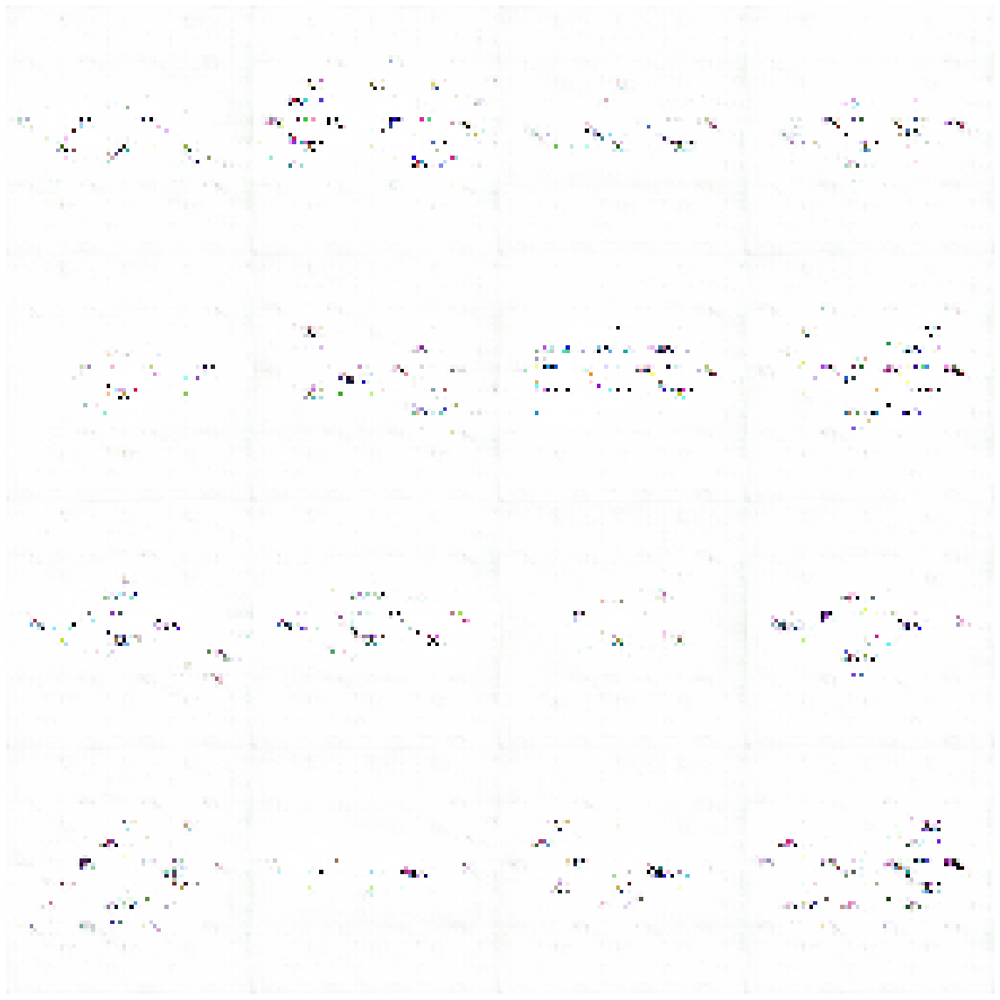

Disc: real loss: 0.374502 fake loss: 0.383616
GAN loss: 2.779143
Step 1900 completed. Time took: 0 secs.
Begin step:  1901
Disc: real loss: 0.389008 fake loss: 0.377153
GAN loss: 1.929176
Step 1901 completed. Time took: 0 secs.
Begin step:  1902
Disc: real loss: 0.338596 fake loss: 0.494869
GAN loss: 3.526579
Step 1902 completed. Time took: 0 secs.
Begin step:  1903
Disc: real loss: 0.478457 fake loss: 0.363808
GAN loss: 2.156208
Step 1903 completed. Time took: 0 secs.
Begin step:  1904
Disc: real loss: 0.319130 fake loss: 0.400477
GAN loss: 2.875104
Step 1904 completed. Time took: 0 secs.
Begin step:  1905
Disc: real loss: 0.333422 fake loss: 0.282976
GAN loss: 2.595771
Step 1905 completed. Time took: 0 secs.
Begin step:  1906
Disc: real loss: 0.352370 fake loss: 0.361549
GAN loss: 2.613612
Step 1906 completed. Time took: 0 secs.
Begin step:  1907
Disc: real loss: 0.353453 fake loss: 0.327570
GAN loss: 2.480681
Step 1907 completed. Time took: 0 secs.
Begin step:  1908
Disc: real loss:

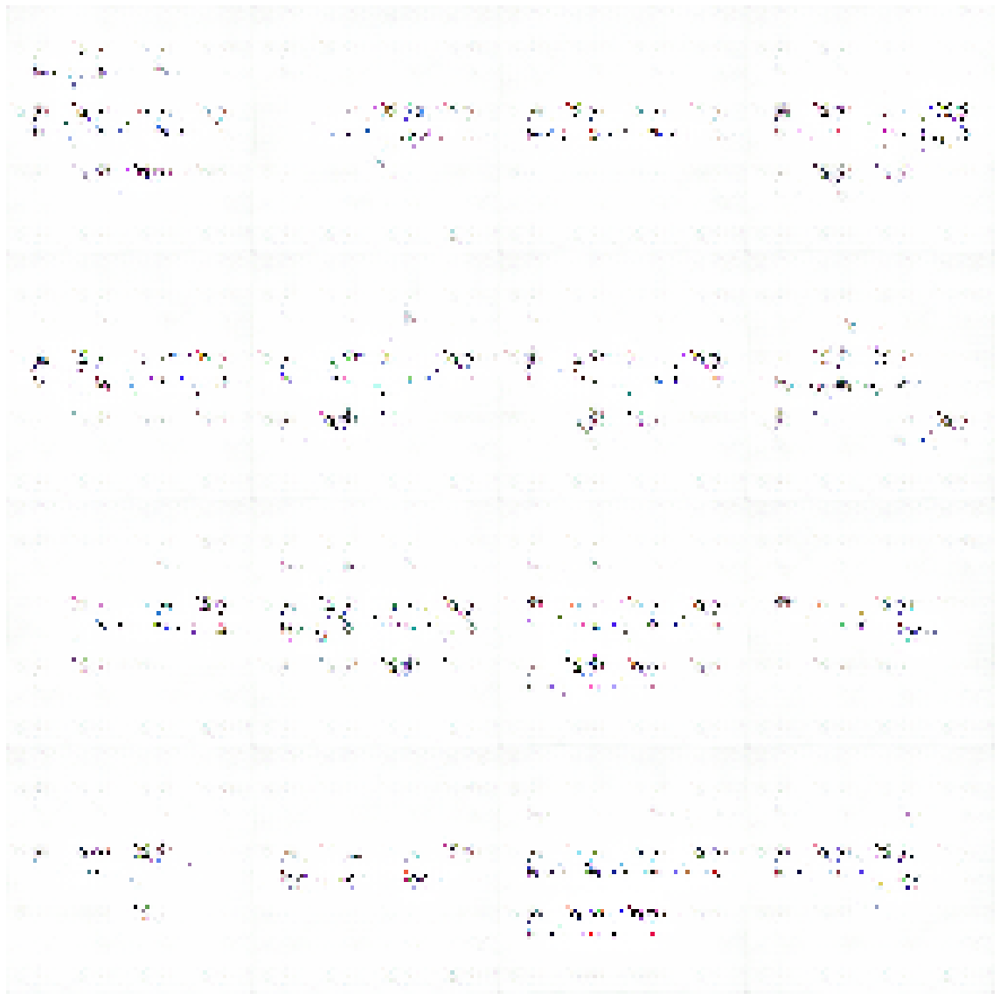

Displaying generated images


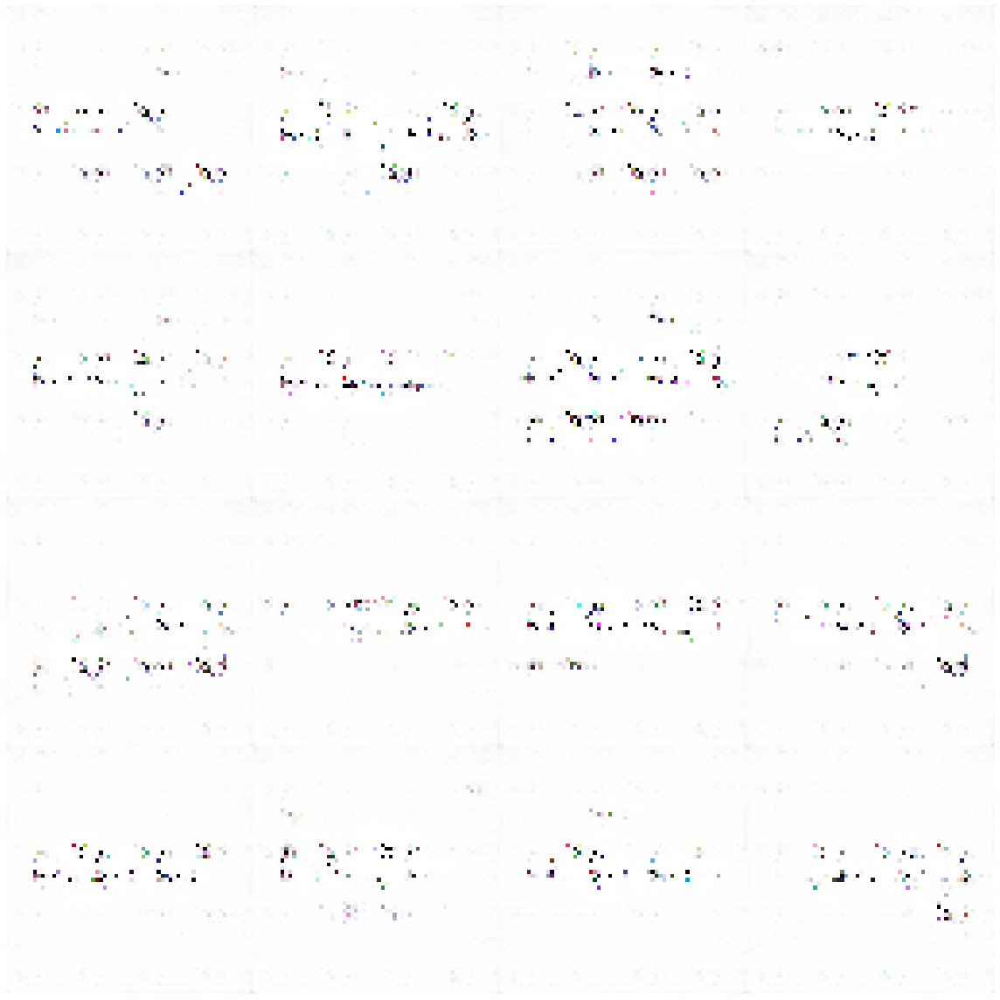

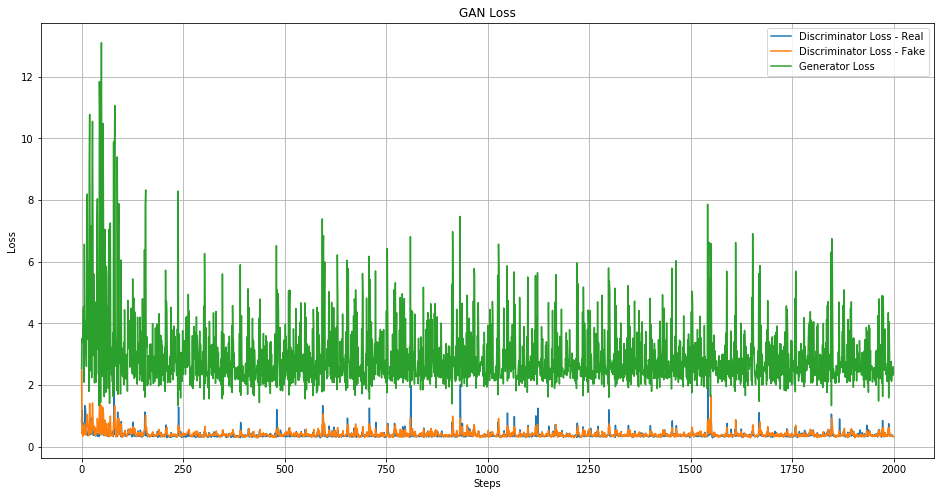

In [14]:
#import argparse
#
#ap = argparse.ArgumentParser()
#ap.add_argument("-d", "--data_dir", type=str, default=r'D:\work\Ames_data\work\rdkit_img'
#                , help="train image dir path.")
#args = vars(ap.parse_args())
#
#data_dir = args['data_dir']

data_dir = r'D:\work\Ames_data\work\rdkit_img'

if __name__ == '__main__':
    main(data_dir=data_dir)

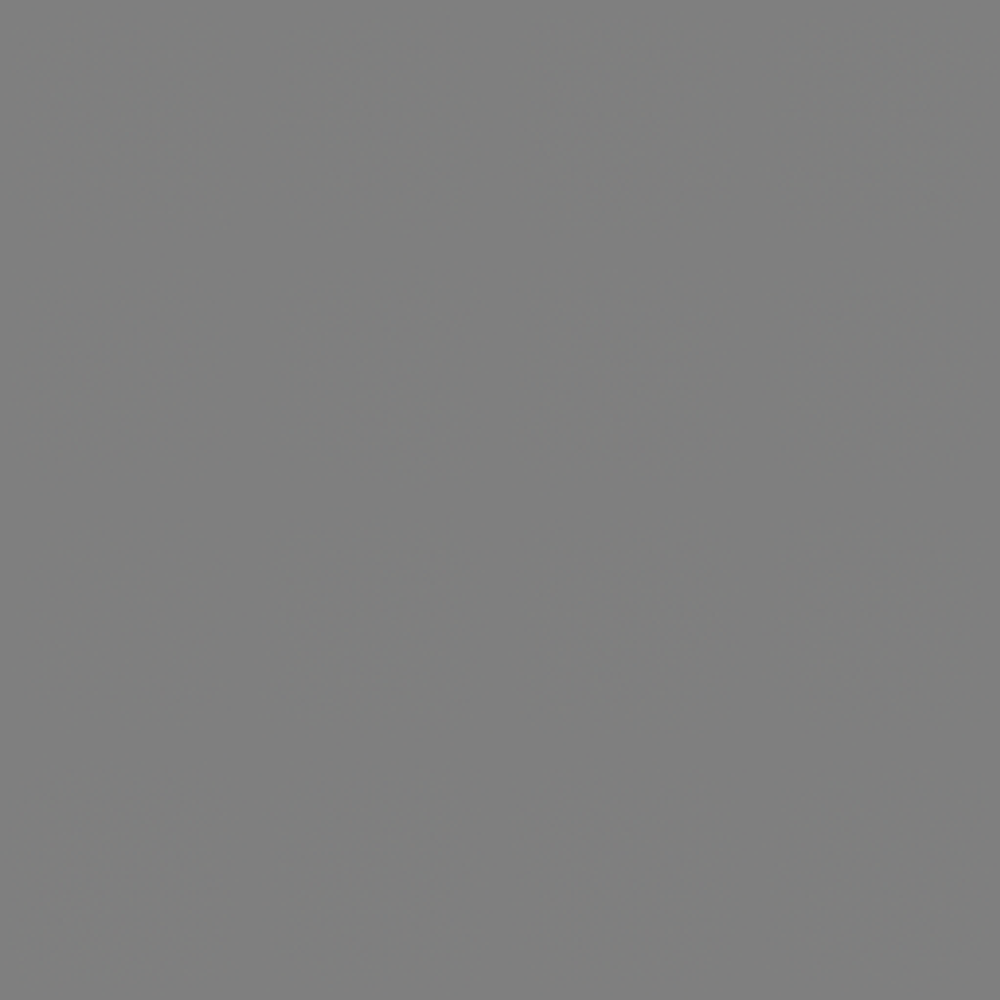

In [15]:
from IPython.display import Image
with open("images/movie.gif",'rb') as f:
    display(Image(data=f.read(), format='png'))

In [20]:
real_data_Y = np.ones(batch_size) - np.random.random_sample(batch_size)*0.2
fake_data_Y = np.random.random_sample(batch_size)*0.2

print(real_data_Y)
print(fake_data_Y)

[0.87773068 0.98601193 0.9077771  0.96138525 0.90436512 0.90890174
 0.90709071 0.90074809 0.93348547 0.80339322 0.87415858 0.80047196
 0.98860447 0.8978113  0.91959551 0.86046916 0.92861005 0.8955978
 0.97432525 0.84783383 0.92031451 0.84649052 0.9805219  0.93528229
 0.98269661 0.84311753 0.96073313 0.97604793 0.82486651 0.82458364
 0.98363542 0.96214902 0.94496552 0.82378618 0.97531964 0.8994964
 0.98145054 0.81795197 0.92077034 0.9712113  0.95187402 0.99115241
 0.9170834  0.97269151 0.934942   0.80716348 0.90770264 0.8515846
 0.93047818 0.96138992 0.94472566 0.91727748 0.8181223  0.97509415
 0.82975242 0.80590466 0.91414606 0.98152535 0.85506119 0.97867596
 0.95360295 0.99108072 0.85011777 0.84849665]
[0.13897641 0.09529985 0.07705325 0.04247064 0.12089755 0.10159468
 0.00312907 0.16970392 0.13765579 0.09631666 0.06674589 0.00326183
 0.0306956  0.1490903  0.00993822 0.02035883 0.05820538 0.12451854
 0.04961629 0.13154599 0.04089924 0.06669441 0.05936048 0.18792335
 0.10926904 0.15030

In [23]:
GAN_X = gen_noise(batch_size,noise_shape)
GAN_Y = real_data_Y

print(GAN_X)
print(GAN_Y)

[[[[ 0.85943297  1.25896933 -0.51969084 ... -0.29061829 -1.15822737
    -0.28210504]]]


 [[[-1.31096461 -0.6055247  -1.52256049 ...  1.38615326 -0.12472376
    -0.15848539]]]


 [[[-0.13592709  0.5240837  -0.57498454 ... -0.70867581  0.18546936
     0.14874118]]]


 ...


 [[[-0.34679895  0.20970357  0.01169282 ...  1.79036555 -0.29556687
    -0.04430759]]]


 [[[-0.05591481 -0.62651189 -0.32286315 ...  0.58941422  0.09594272
    -1.56834674]]]


 [[[ 0.00266167 -0.54894232 -1.80227575 ...  0.03342577 -0.40264152
    -0.74606808]]]]
[0.87773068 0.98601193 0.9077771  0.96138525 0.90436512 0.90890174
 0.90709071 0.90074809 0.93348547 0.80339322 0.87415858 0.80047196
 0.98860447 0.8978113  0.91959551 0.86046916 0.92861005 0.8955978
 0.97432525 0.84783383 0.92031451 0.84649052 0.9805219  0.93528229
 0.98269661 0.84311753 0.96073313 0.97604793 0.82486651 0.82458364
 0.98363542 0.96214902 0.94496552 0.82378618 0.97531964 0.8994964
 0.98145054 0.81795197 0.92077034 0.9712113  0.95187402 0.99